# Download and Install Textflow

In [ ]:
!git clone https://github.com/sinai-uja/textflow.git
!(cd textflow; python -m pip install .)

**Note:** In this point is important to restart the virtual enviroment. If you do not restart the enviroment probably get an AttributeError: module 'numpy.linalg._umath_linalg' has no attribute '_ilp64'

## Load the data

In this case, we are going to use the validation set from [OffendES: A New Corpus in Spanish for Offensive Language Research](https://aclanthology.org/2021.ranlp-1.123) (Plaza-del-Arco et al., RANLP 2021)



In [1]:
import os
import pandas as pd
import warnings
warnings.filterwarnings('ignore')

pathValidationSet = './validation.csv'
dicLabel={0: 'OFP', 1: 'OFG', 2: 'NO', 3: 'NOM'}
df = pd.read_csv(pathValidationSet)
df['label']=[dicLabel[df['label'][i]] for i in df.index]

In [2]:
df

,comment_id,comment,influencer,influencer_gender,media,label
0,27341,Me encanta el videooo porciento aidii he subid...,dulceida,woman,youtube,NO
1,21310,"Ropa cara?veo dulceida shop, Zara.. y de todas...",lauraescane,woman,youtube,NO
2,23809,Y la perra seguia y seguia.jpg :v,windygirk,woman,youtube,OFP
3,14532,Malditas drogas,wismichu,man,youtube,NO
4,51651,"perdona el spam , es la primera vez que trato ...",dalas,man,instagram,NO
...,...,...,...,...,...,...
95,58740,Me alegra dalas . Soy nuevo seguidor y me aleg...,dalas,man,instagram,NO
96,6796,En resumen Dalas le callo la puta boca.,nauterplay,man,youtube,NOM
97,53415,"Genial!! Que te lleven a Alcaser, a ver las Ca...",soyunapringada,woman,instagram,NO
98,49449,Hola dalas quiero que sepáis que tienes mi tot...,dalas,man,instagram,NO


# Analyzing the data

In [3]:
import nltk
import re
from nltk.corpus import stopwords
from nltk.tokenize import RegexpTokenizer, WordPunctTokenizer
nltk.download('stopwords')
from nltk.stem import WordNetLemmatizer
nltk.download("wordnet")
nltk.download("omw-1.4")

[nltk_data] Downloading package stopwords to
[nltk_data]     /home/mevr0003/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /home/mevr0003/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /home/mevr0003/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

In [3]:
#Go to the textflow path
os.chdir('/home/mevr0003/proyectos/textflow')

In [5]:
#Import the analyzers
from textflow.BDLASEAnalyzer import BDLASEAnalyzer
from textflow.ComplexityAnalyzer import ComplexityAnalyzer
from textflow.EmofinderAnalyzer import EmofinderAnalyzer
from textflow.EmojiAnalyzer import EmojiAnalyzer
from textflow.EmojiPolarityAnalyzer import EmojiPolarityAnalyzer
from textflow.EmoticonsPolarityAnalyzer import EmoticonsPolarityAnalyzer
from textflow.EmotionAnalyzer import EmotionAnalyzer
from textflow.IronyAnalyzer import IronyAnalyzer
from textflow.IsalAnalyzer import IsalAnalyzer
from textflow.LemmaAnalyzer import LemmaAnalyzer
from textflow.LexicalDiversityAnalyzer import LexicalDiversityAnalyzer
from textflow.LiwcAnalyzer import LiwcAnalyzer
from textflow.NcrAnalyzer import NcrAnalyzer
from textflow.NERAnalyzer import NERAnalyzer
from textflow.NGramsAnalyzer import NGramsAnalyzer
from textflow.PerplexityAnalyzer import PerplexityAnalyzer
from textflow.PolarityAnalyzer import PolarityAnalyzer
from textflow.POSAnalyzer import POSAnalyzer
from textflow.SelAnalyzer import SelAnalyzer
from textflow.StylometryAnalyzer import StylometryAnalyzer
from textflow.VolumetryAnalyzer import VolumetryAnalyzer

#Import the sequence string
from textflow.SequenceString import SequenceString

[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.9/12.9 MB 59.2 MB/s eta 0:00:00
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


  Using cached https://github.com/explosion/spacy-models/releases/download/es_core_news_sm-3.7.0/es_core_news_sm-3.7.0-py3-none-any.whl (12.9 MB)
✔ Download and installation successful
You can now load the package via spacy.load('es_core_news_sm')


[nltk_data] Downloading package punkt to /home/mevr0003/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


**Note:** It is important to download the resource that we are going to use in the analyzers.

In the lower code cell the analyzers are defined. These analyzers have many parameters that can be modified as desired. For more information, access the official [documentation](https://github.com/sinai-uja/textflow)

In [6]:
#Create the analyzers with their parameters
bdlase = BDLASEAnalyzer()
complexity = ComplexityAnalyzer() 
emofinder = EmofinderAnalyzer() 
emoji = EmojiAnalyzer() 
emojiPolarity = EmojiPolarityAnalyzer(positiveEmojiPath = "./textflow/emojis/emojiPositive.txt", negativeEmojiPath = './/textflow/emojis/emojiNegative.txt')
emoticonsPolarity = EmoticonsPolarityAnalyzer(positiveEmojiPath = ".//textflow/emoti-sp/emoticonsPositive.txt", negativeEmojiPath = './/textflow/emoti-sp/emoticonsNegative.txt')
emotion = EmotionAnalyzer()
ironity = IronyAnalyzer()
isal = IsalAnalyzer()
lemma = LemmaAnalyzer()
lexicalDiversity = LexicalDiversityAnalyzer(lemmatizer=WordNetLemmatizer().lemmatize)
liwc = LiwcAnalyzer()
ncr = NcrAnalyzer()
ner = NERAnalyzer()
n1 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 1)
n2 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 2,stopwords=[])
n3 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 3,stopwords=[])
n4 = NGramsAnalyzer(tokenizer=RegexpTokenizer(r"[\w']+"),ngramsSize = 4,stopwords=[])
perplexity = PerplexityAnalyzer(device="cpu")
polarity = PolarityAnalyzer()
pos = POSAnalyzer()
sel = SelAnalyzer()
stylometry = StylometryAnalyzer(stopwords.words('spanish'),tokenizer = WordPunctTokenizer())
volumetry = VolumetryAnalyzer()

#Create our list of sequences. 
## In this case, we are going to use Sequence from String using our text column in the DataFrame
## Althought there are more types of Sequences and you can create your own Sequence. For more information about Sequence go to https://github.com/sinai-uja/textflow?tab=readme-ov-file#how-to-create-a-sequence
listSequence = []
for index, row in df.iterrows():
  s = SequenceString(row["comment"])
  listSequence.append(s)

Xformers is not installed correctly. If you want to use memory_efficient_attention to accelerate training use the following command to install Xformers
pip install xformers.


In [7]:
#Analyze each sequence of our list of sequences. Each analyzer function receives:
  #  sequence: the Sequence we want to analyze.
  #  tag: the label to store the analysis result.
  #  levelOfAnalyzer: the path of the sequence level to analyze inside of the result.
  #  levelOfResult: [OPTIONAL] the path of the sequence level to store the result.

for s in listSequence:
  bdlase.analyze(s,"bdlase","text")
  complexity.analyze(s,"complexity","text")
  emofinder.analyze(s,"emofinder","text")
  emoji.analyze(s,"emoji","text")
  emojiPolarity.analyze(s,"emojiPolarity","text")
  emoticonsPolarity.analyze(s,"emoticons","text")
  emotion.analyze(s,"emotion","text")
  ironity.analyze(s,"ironity","text")
  isal.analyze(s,"isal","text")
  lemma.analyze(s,"lemmas","text")
  lexicalDiversity.analyze(s,"lexicalDiversity","text")
  liwc.analyze(s,"liwc","text")
  ncr.analyze(s,"ncr","text")
  ner.analyze(s,"NER","text")
  n1.analyze(s,"1-grams","text")
  n2.analyze(s,"2-grams","text")
  n3.analyze(s,"3-grams","text")
  n4.analyze(s,"4-grams","text")
  perplexity.analyze(s,"perplexity","text")
  polarity.analyze(s,"polarity","text")
  pos.analyze(s,"POS","text")
  sel.analyze(s,"sel","text")
  stylometry.analyze(s,"stylometry","text")
  volumetry.analyze(s,"volumetry","text")

  0%|          | 0/1 [00:00<?, ?it/s]


In [8]:
# In order to know more about a sequence, I show you the Sequence structure
s

Sequence(
  format: string
  metadata: {'text': 'Por que crees que hablan mal de ti 1 haces mucha polemica 2 muestras mucho tu escote y ya nos cansamos 3 casi la mitad de tus subs son haters También pones títulos con doble sentido Y aún hay más', 'bdlase': [[[0.0, 0.0, 0.6666666666666666, 0.3333333333333333], [0.0, 0.0, 0.6666666666666666, 0.3333333333333333], [0.0, 0.0, 0.0, 0.0], [0.0, 0.0, 0.6666666666666666, 0.3333333333333333]]], 'complexity': [{'nSentences': 2, 'nComplexSentence': 0, 'avglenSentence': 20.0, 'nPuntuationMarks': 0, 'nWords': 40, 'nRareWords': 11, 'nSyllabes': 61, 'nChar': 3, 'ILFW': 0.42857142857142855, 'LDI': 7.0, 'LC': 3.7142857142857144, 'SSR': 145.425, 'SCI': 10.0, 'ARI': 10.35325, 'huerta': 185.525, 'IFSZ': 91.82750000000001, 'polini': 51.097500000000004, 'mu': 99.20007956579805, 'minage': 7.7268574999999995, 'SOL': 6.489691271489054, 'crawford': 3.0404999999999998, 'min_depth': 1, 'max_depth': 8, 'mean_depth': 4.5}], 'emofinder': [[[0.0, 0.0, 0.0, 0.0], [0.0,

With the nexxt cells of code we are going to create a DataFrame with the results of the analyzers.

In [9]:
# Calculate all of POS tags that are present in our sequences
## To do that, we go to the level where the results of the POS analyzer is saved 
## and create a set with all of the tags
POStags = set()
for seq in listSequence:
  for tag in seq.metadata['POS'][0]['FreqPOS']:
    POStags.add(tag)

In [10]:
#We need to define a list with all of the analyzer labels
labels = ["bdlase","complexity","emofinder","emoji","emojiPolarity","emoticons","emotion","ironity","isal","lemmas","lexicalDiversity","liwc","ncr","NER","1-grams","2-grams","3-grams","4-grams","perplexity","polarity","POS","sel","stylometry","volumetry"]

#Create a dictionary that will save all the information of the sequences, this dictionary will have as 
#keys the analyzer labels + analyzer metric and as value of each key a list with the value of obtained by analyzes the sequences contained in listSequence  
dicTotal = {}
for seq in listSequence:
  for l in seq.metadata:
    if l in labels:
      if l in ["polarity", "emotion", "ironity"]:
        for category in seq.metadata[l][0][0]:
          l_key = str(l+category['label'])
          dicTotal[l_key] = dicTotal.get(l_key, []) + [category['score']]
      elif l == 'POS':
        for cat in ['FreqPOS', 'RelFreqPOS']:
          for tag in POStags:
            dicTotal[cat+''+tag] = dicTotal.get(cat+''+tag, []) + [seq.metadata[l][0][cat].get(tag, 0)]
        l_key = str(l)+'POSTokens'
        dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0]['POSTokens']]
      elif l == 'perplexity':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      elif l == 'bdlase' or l == 'emofinder' or  l=='isal'or l == 'liwc' or l=='ncr' or l=='sel':
        dicTotal[l] = dicTotal.get(l, []) + [seq.metadata[l][0]]
      else:
        for key in seq.metadata[l][0]:
          l_key = str(l+key)
          dicTotal[l_key] = dicTotal.get(l_key, []) + [seq.metadata[l][0][key]]

#Once we hace a dictTotal with all of the information of the sequences, we are going to create the DataFrame
for k in dicTotal:
  df[str(k)] = dicTotal[k]

#We show the columns of the dataFrame
print(df.columns.to_list())
#Save the DataFrame as csv File
df.to_csv('/home/mevr0003/proyectos/textflow/Examples/df_with_textflow_analysis.csv', index='False')

['comment_id', 'comment', 'influencer', 'influencer_gender', 'media', 'label', 'bdlase', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emofinder', 'emojiTextWithoutEmoji', 'emojiFreqEmoji', 'emojiNumEmojis', 'emojiPolaritynumEmojisPolarity', 'emojiPolaritypercentageEmojisPolarity', 'emojiPolaritydistinctEmojiFounded', 'emoticonsnumTextEmojisPolarity', 'emoticonspercentageTextEmojiPolarity', 'emoticonsdistinctTextEmojiFounded', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionf

# Results of Data Analysis

In [4]:
#Import the Test and Visualization Modules of TextFlow
import os
import pandas as pd
from textflow.Test import Test
from textflow.Visualization import Visualization

In [5]:
#Read the dataFrame with all the results of the analyzer for each sequence
df = pd.read_csv('./Examples/df_with_textflow_analysis.csv')

#If we load the DataFrame from csv, some dict, list and other types of object are of string type, so we need to use the eval function
df['1-gramsfreqN-Grams']=df['1-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['2-gramsfreqN-Grams']=df['2-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['3-gramsfreqN-Grams']=df['3-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['4-gramsfreqN-Grams']=df['4-gramsfreqN-Grams'].apply(lambda x: eval(x))
df['POSPOSTokens']=df['POSPOSTokens'].apply(lambda x: eval(x))

#We pass the labels to number
#dicLabel={'OFP': 0, 'OFG': 1 ,'NO':2 , 'NOM':3}
#df['label']=df['label'].apply(lambda x: dicLabel[x])

## Most Frequent Words, N-grams and POS words

In [6]:
#Create the visualization object
# It receives:
## savePath: an string with the path where different graphics where be saved. By default savePath= '.'
## n_cols: the number of columns of the subplot grid. By default n_cols=6
## cmap: a colormap that is apply to the images. By default cmap=sns.diverging_palette(230, 20, as_cmap=True)
visualizer = Visualization()

### WordClouds


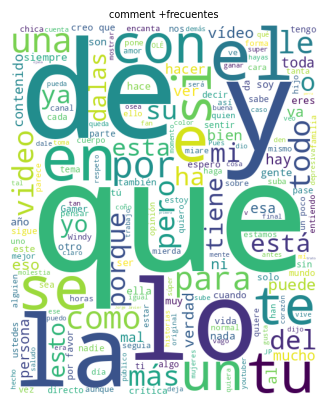

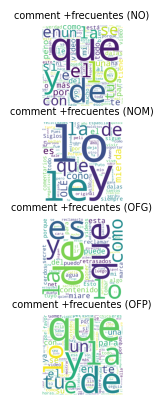

In [15]:
# We use the wordCloud function of the visualizer to see the most frequent words
## All of the dataset (without groupby)
visualizer.show_wordCloud(df,['comment'])
## For each label of the dataset (Grouping the DF by 'label column)
visualizer.show_wordCloud(df,['comment'],groupby='label')

### N-Gramas

<Figure size 640x480 with 0 Axes>

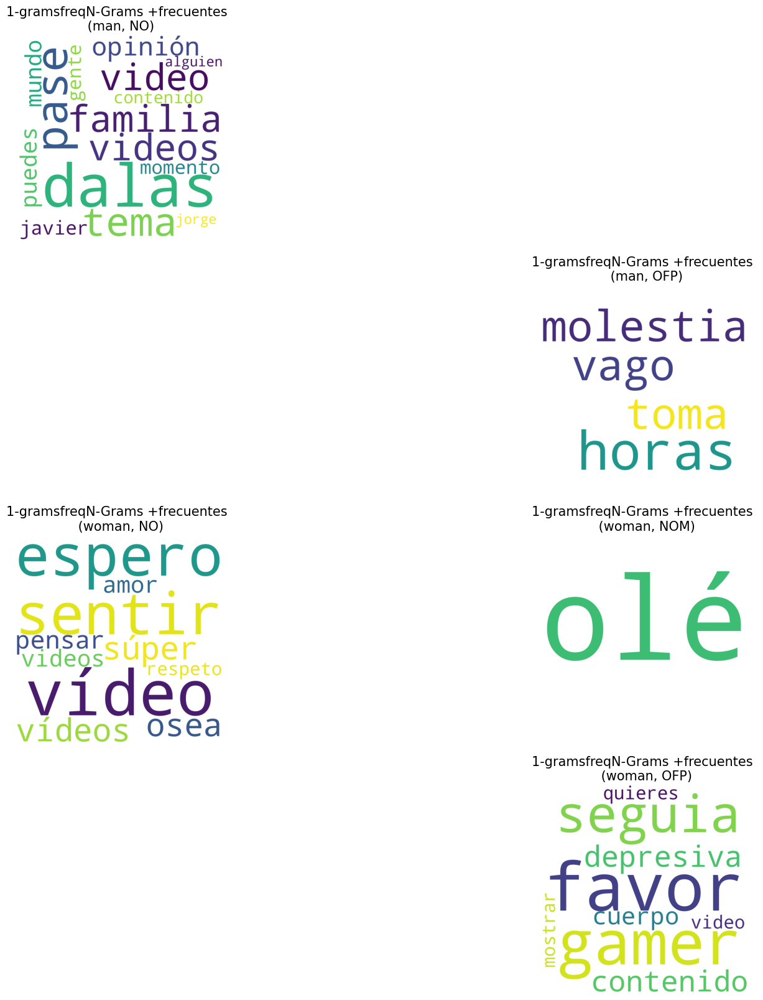

<Figure size 640x480 with 0 Axes>

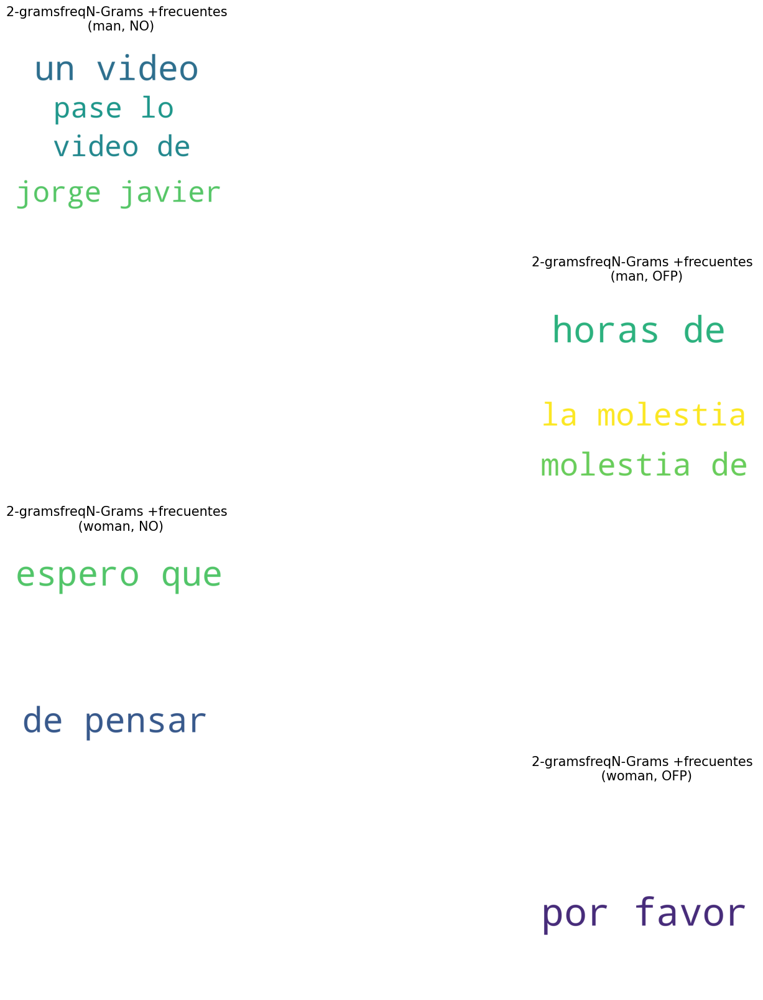

<Figure size 640x480 with 0 Axes>

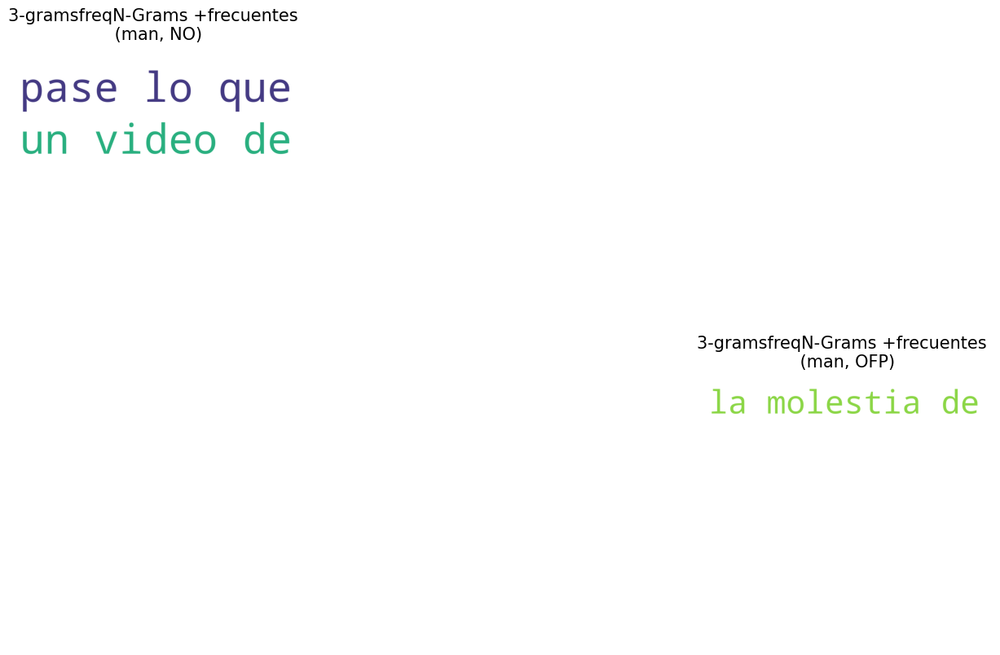

<Figure size 640x480 with 0 Axes>

<Figure size 2000x2000 with 0 Axes>

In [16]:
# Import the spanish stopwords
from spacy.lang.es.stop_words import STOP_WORDS

# Create a new DataFrame
new_df = pd.DataFrame()
# For each n-grams calculated with the analyzers (In this examples we have 1 to 4 n-grams)
for ngramas in [str(n+1)+"-gramsfreqN-Grams" for n in range(4)]:
    # We group the DataFrame by the columns 'influencer_gender' and 'label'. Using an aggregation function that will create a dictionary that contains:
    ## the sum of the occurrences of each unique element of all lists in the n-gram column grouped by 'influencer_gender' and 'label'. 
    ## This dictionary is sorted in descending order 
    newdf = df.groupby(['influencer_gender', 'label'])[ngramas].agg(lambda x: dict(sorted({k: sum(d.get(k, 0) for d in x) for k in set().union(*x)}.items(), key=lambda item:item[1], reverse=True))).reset_index()
    # Create an empty list to store the ngram dictionaries
    ngramsArray=[]
    # Iterate over the rows of the newly created dataframe
    for i in newdf.index:
        # Copy the ngram dictionary of each row of the newdf
        ngramsDict= newdf[ngramas][i].copy()
        # Check that the n-grams of the dictionary do not contain empty words and have more than 3 letters.
        for k in newdf[ngramas][i]:
            valid = False
            for e in k.split(' '):
                if e not in STOP_WORDS and len(e) > 1:
                    valid = True
                    break
            if not valid or ngramsDict[k] < 3:
                del ngramsDict[k]
        ngramsArray.append(ngramsDict)
    # Modify the columns of new_df with the information selected in the previous process to display the word cloud.     
    new_df[ngramas], new_df['Sexo'], new_df['label'] = ngramsArray, newdf['influencer_gender'], newdf['label']
# Displayed the word cloud according to the gender of the person and the offensiveness tag.
visualizer.show_wordCloud(new_df,[str(n+1)+"-gramsfreqN-Grams" for n in range(4)], widthGraphic = 20,heightGraphic=20,hspace= 0.25,titleGraphicSize= 15,groupby=['Sexo','label'])

### POS

<Figure size 640x480 with 0 Axes>

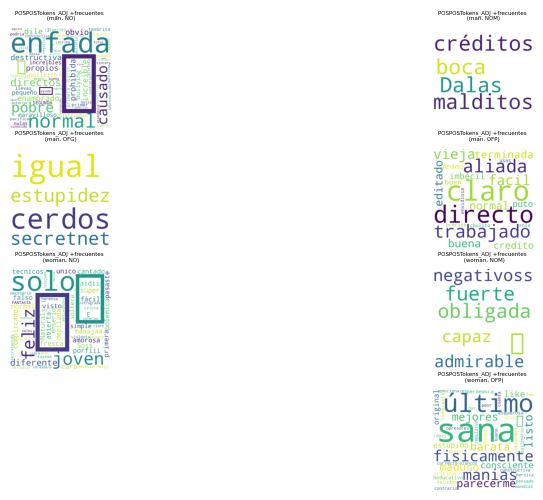

<Figure size 640x480 with 0 Axes>

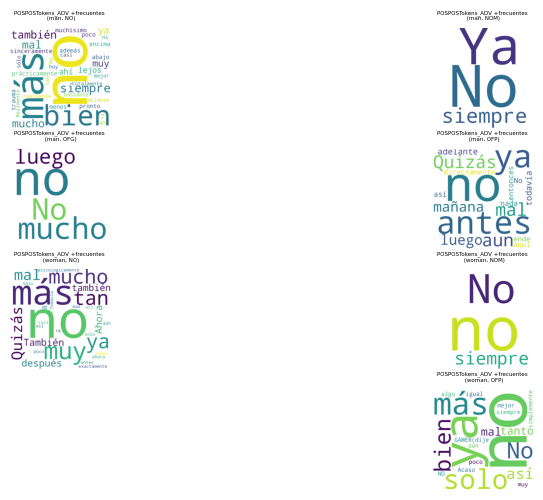

<Figure size 640x480 with 0 Axes>

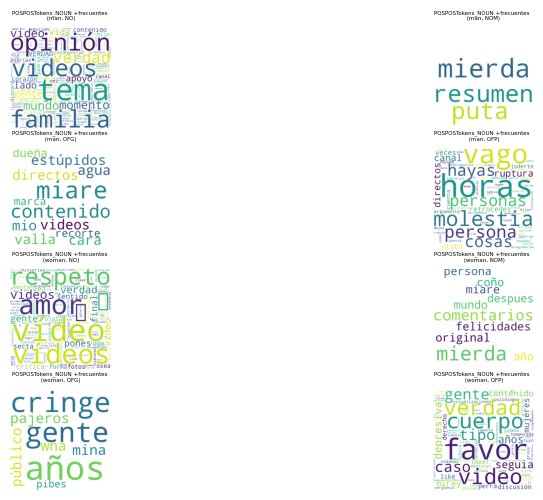

<Figure size 640x480 with 0 Axes>

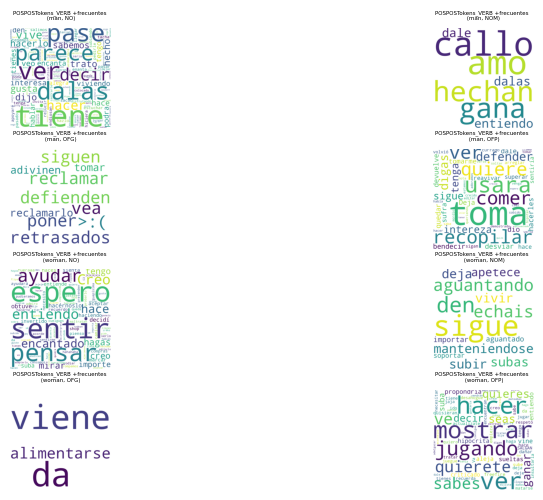

In [17]:
# Define a list of POS tags from which we want to obtain a word cloud.
POS_LIST = ["ADJ", "ADV", "NOUN", "VERB"]

# Initialize new_df as an empty DataFrame
new_df = pd.DataFrame()
# Initialize the boolean variable first to true. This variable will represent if it is the first iteration of our loop. 
first=True
# For each item in the POS tag list
for pos in POS_LIST:
    # Create a new column in the DataFrame df, whose name is defined by 'POSPOSTokens' and the value of the variable pos. 
    ## The values in this column will be the values associated with the pos key in the dictionary stored in the 'POSPOSTokens' column for each row of the DataFrame. 
    ## If the pos key is not present in the dictionary, an empty dictionary {} will be assigned.
    df['POSPOSTokens'+"_"+pos] = [df['POSPOSTokens'][i].get(pos, {}) for i in df.index]
    # Create a new DataFrame 'newdf' that will save the results of the agrupation of df by the columns 'influencer_gender' and 'label'. The aggregation function used to group these two columns 
    # consist in the creation of a dictionary that calculated the occurrences of the pos elements in the 'POSPOSTokens' columns, sorted by value in descending order.
    newdf = df.groupby(['influencer_gender', 'label'])['POSPOSTokens_'+pos].agg(lambda x: dict(sorted({k: sum(d.get(k, 0) for d in x) for k in set().union(*x)}.items(), key=lambda item:item[1], reverse=True))).reset_index()
    # If is not the first iteration , we remove the columns 'influencer_gender' and 'label' of newdf DataFrame.
    newdf = newdf.drop(['influencer_gender', 'label'], axis=1) if first==False else newdf
    # Establish the value of first to False
    first = False
    #Join the two DataFrames(new_df and newdf)
    new_df = pd.concat([new_df, newdf], axis=1)
# Displayed the word cloud according to the gender of the person and the offensiveness tag.
visualizer.show_wordCloud(new_df,['POSPOSTokens'+"_"+pos for pos in POS_LIST], hspace= 1.2,titleGraphicSize= 4,groupby=['influencer_gender','label'])

## Normality and significant Tests

### Tests with visualization graphics

---------------------------------------NORMALITY TEST---------------------------------------
Columnas 97
Pass the test of Shapiro
['complexitySSR', 'lexicalDiversityRootTTR', 'stylometryDugast']
Pass the test of D'Agostino
['complexityILFW', 'complexitySSR', 'lemmasavgLemmas', 'lexicalDiversityRootTTR', 'RelFreqPOSPRON', 'RelFreqPOSVERB', 'RelFreqPOSDET', 'stylometryDugast']
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 15.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 10.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 5.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 2.5 level of significance
Pass the test of Anderson-Darling
['comp

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,lexicalDiversityMTLDMAWrap,Hombre,Mujer,1336.0,0.553190,0.229130,0.819741,0.055940,0.813525
1,RelFreqPOSNUM,Hombre,Mujer,1301.5,0.635431,0.982589,0.330737,0.749559,0.388730
2,complexitynChar,Hombre,Mujer,1217.5,0.826474,-0.482126,0.631908,0.233411,0.630084
3,lemmasavgLemmas,Hombre,Mujer,1324.5,0.543245,0.741929,0.461745,0.637915,0.426398
4,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,0.927146,0.358490,1.130191,0.290347
5,stylometryMass,Hombre,Mujer,1142.0,0.460631,0.046439,0.963153,0.009839,0.921190
6,Unnamed: 0,Hombre,Mujer,1255.0,0.972498,4.199258,0.000115,0.001424,0.969978
7,complexitymax_depth,Hombre,Mujer,1405.0,0.279990,1.513681,0.136664,2.192915,0.141855
8,RelFreqPOSPROPN,Hombre,Mujer,1114.0,0.345317,-0.545651,0.587833,0.461203,0.498663
9,RelFreqPOSPUNCT,Hombre,Mujer,1262.5,0.930888,-0.609495,0.545071,0.353801,0.553340


{'Students t-test': {'Reject H0': ['emotionjoy', 'emotionothers', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['lexicalDiversityMTLDMAWrap', 'RelFreqPOSNUM', 'complexitynChar', 'lemmasavgLemmas', 'complexitynComplexSentence', 'stylometryMass', 'Unnamed: 0', 'complexitymax_depth', 'RelFreqPOSPROPN', 'RelFreqPOSPUNCT', 'complexityILFW', 'ironityI', 'lexicalDiversityMaasTTR', 'lexicalDiversityMTLDMABi', 'complexitynSentences', 'RelFreqPOSAUX', 'RelFreqPOSSYM', 'lexicalDiversityMATTR', 'polarityPOS', 'RelFreqPOSSPACE', 'RelFreqPOSINTJ', 'emotiondisgust', 'polarityNEG', 'lexicalDiversityRootTTR', 'stylometryTTR', 'emotionsurprise', 'volumetryavgWordsLen', 'lexicalDiversityMSTTR', 'lexicalDiversityMTLD', 'stylometryRTTR', 'RelFreqPOSPRON', 'complexitySSR', 'RelFreqPOSADV', 'emotionanger', 'ironityNI', 'RelFreqPOSDET', 'lexicalDiversitySimpleTTR', 'lexicalDiversityHDD', 'polarityNEU', 'RelFreqPOSNOUN', 'stylometryDugast', 'complexitymean_depth', 'comment_id', 'FreqPOSINTJ', 'emotionsadness', 'Re

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,Hombre,Mujer,1255.0,0.972498,282.5,0.000778,0.001438,0.969749
1,comment_id,Hombre,Mujer,1377.0,0.381198,498.0,0.259326,0.772883,0.379327
2,label,Hombre,Mujer,1489.5,0.052642,99.0,0.015211,3.770943,0.052150
3,complexitynSentences,Hombre,Mujer,1137.0,0.402759,232.5,0.549671,0.706340,0.400662
4,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,110.0,0.347515,0.551709,0.457620
...,...,...,...,...,...,...,...,...,...
92,stylometryHonore,Hombre,Mujer,1125.5,0.394419,465.0,0.144754,0.731160,0.392507
93,volumetrywords,Hombre,Mujer,1332.5,0.569346,504.0,0.388857,0.327714,0.567008
94,volumetryuniqueWords,Hombre,Mujer,1343.5,0.518923,486.0,0.408999,0.420495,0.516690
95,volumetrychars,Hombre,Mujer,1330.0,0.581196,509.5,0.420737,0.308121,0.578835


{'mannwhitneyu': {'Reject H0': ['complexitypolini', 'emotionothers', 'emotionjoy', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'label', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'le

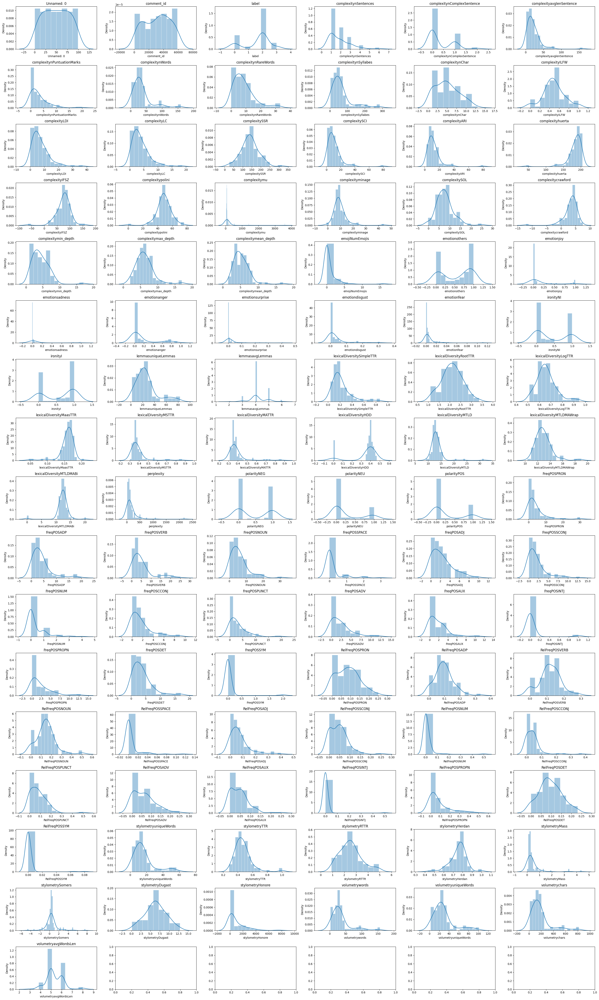

---------------------------------------PROBPLOT GRAPHICS---------------------------------------


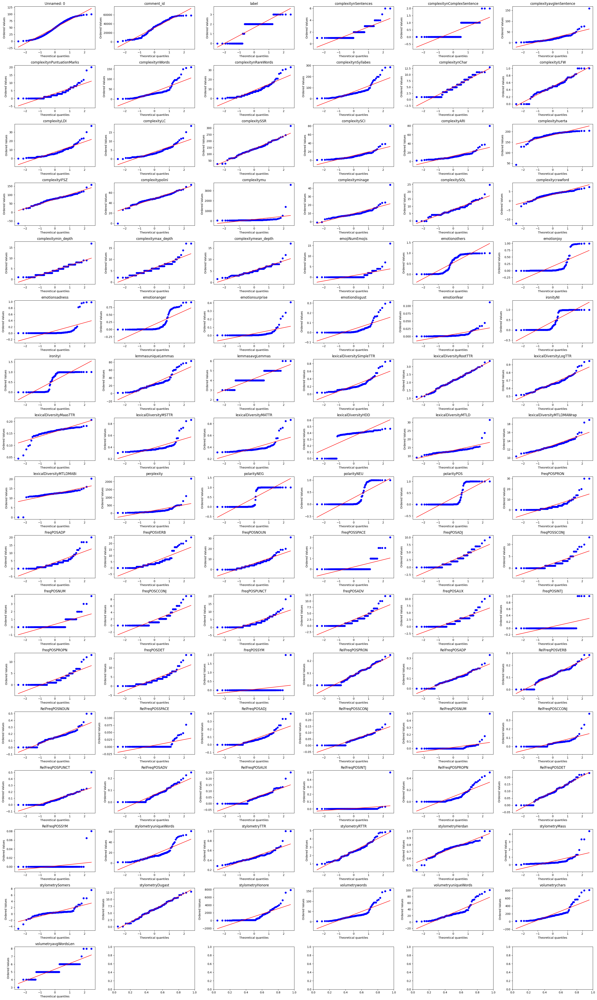

---------------------------------------KDE GRAPHICS---------------------------------------


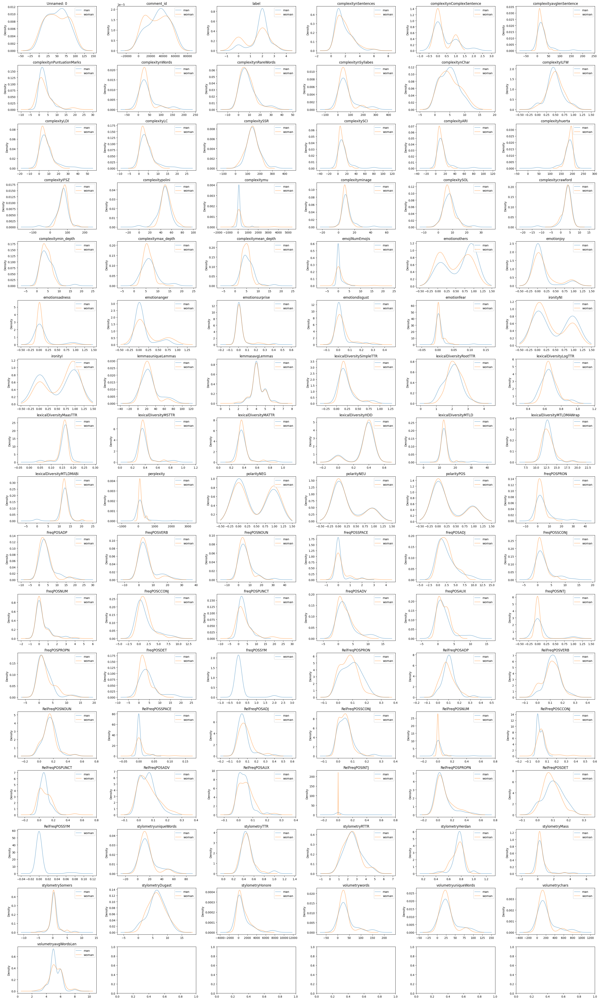

---------------------------------------BOXPLOT GRAPHICS---------------------------------------


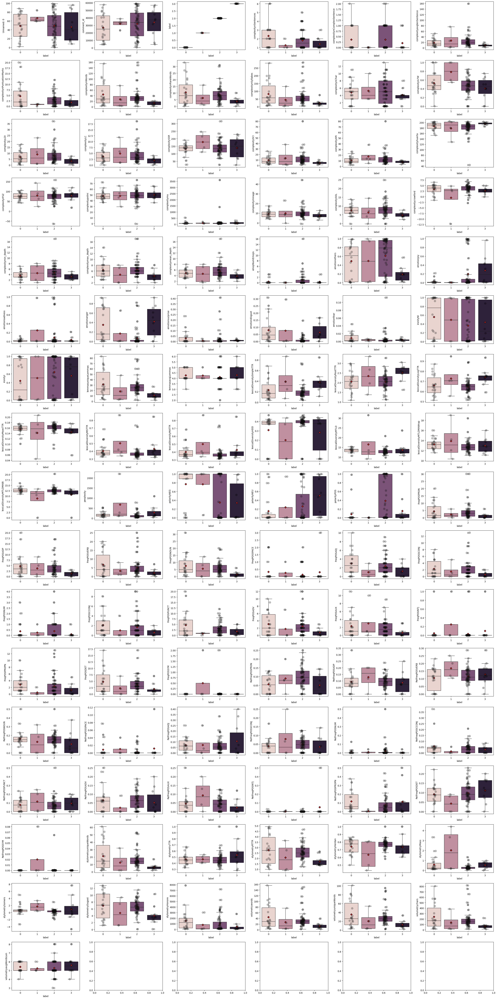

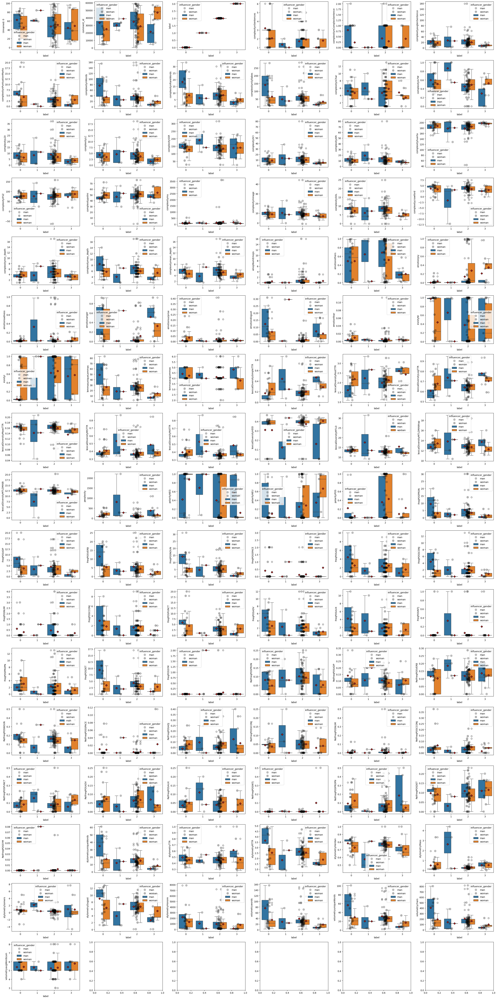

In [14]:
# Create an object of the test class. To create it, this function receives the following parameters:
## normalityTest: a list with the normal tests to apply. Possibles values: ["Shapiro","D'Agostino","Anderson-Darling","Chi-Square","Lilliefors","Jarque–Bera","Kolmogorov-Smirnov"]
## parametricTest: a list with the parametric tests to apply. Possibles values: ["Students t-test","Paired Students t-Test", "ANOVA"]
## nonParametricTest: a list with the non parametric tests to apply. Posibles values: ["mannwhitneyu","wilcoxon","kruskal"]
## alpha: chosen significance level to interpret the p-value in parametric/non parametric tests. Posibles values: float between 0 and 1
t=Test() # By defect: normalityTest=["Shapiro","D'Agostino","Anderson-Darling","Chi-Square","Lilliefors","Jarque–Bera","Kolmogorov-Smirnov"], parametricTest=["Students t-test","Paired Students t-Test", "ANOVA"], nonParametricTest=["mannwhitneyu","wilcoxon","kruskal"],alpha=0.05

# Create a list to store those columns of the dataframe that are numeric
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
# Create the Visualization Object to see the different graphs associated with the test class
v=Visualization()

# With the following line we:
## Calculate some stadistical test: normality tests and significant tests (parametrics and non-parametric)
## Visualize some plots (DISTPLOT, PROBPLOT, KDE and BOXPLOT)
testResults=t.report(df[df['influencer_gender']=="man"],df[df['influencer_gender']=="woman"],"Hombre","Mujer",v,'influencer_gender',['label','label'],[None,'influencer_gender'])

In [15]:
# The function that calculates all these tests returns a dictionary that has 3 keys, the different types of tests that it applies.
# These keys contain the results of applying the tests, returned in a tuple (results dataframe, list of characteristics that pass the test).
testResults.keys()

dict_keys(['normalTest', 'parametricTest', 'nonParametricTest'])

In [16]:
# For each key of the dictionary, a DataFrame is returned with the stadistic value and the p-value of each test applied and as rows the feature on which the test is being applied.
print(testResults['normalTest'][0])
# A dictionary that has as key the applied test and as value a list of tests that pass the results.
print(testResults['normalTest'][1])

                            Shapiro stat  Shapiro p-value  D'Agostino stat  \
Unnamed: 0                      0.954725     1.721887e-03        34.673556   
comment_id                      0.943080     2.986405e-04        36.715430   
label                           0.723401     1.961459e-12        11.002115   
complexitynSentences            0.756587     1.403096e-11        36.226106   
complexitynComplexSentence      0.615949     8.734215e-15        23.645830   
...                                  ...              ...              ...   
stylometryHonore                0.683087     2.214561e-13        63.723534   
volumetrywords                  0.753795     1.180914e-11        53.975317   
volumetryuniqueWords            0.828557     2.065794e-09        35.835871   
volumetrychars                  0.761839     1.947611e-11        52.300309   
volumetryavgWordsLen            0.820888     1.143945e-09        14.969375   

                            D'Agostino p-value  Anderson-Darlin

### Tests without visualization graphics

In [18]:
# Example of applying a test report (calculating normality tests, and significant tests) without including graphs.
t=Test()
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
testResults=t.report(df[df['influencer_gender']=="man"],df[df['influencer_gender']=="woman"],"Hombre","Mujer")

---------------------------------------NORMALITY TEST---------------------------------------
Columnas 96
Pass the test of Shapiro
['complexitySSR', 'lexicalDiversityRootTTR', 'stylometryDugast']
Pass the test of D'Agostino
['complexityILFW', 'complexitySSR', 'lemmasavgLemmas', 'lexicalDiversityRootTTR', 'RelFreqPOSVERB', 'RelFreqPOSDET', 'RelFreqPOSPRON', 'stylometryDugast']
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 15.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 10.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 5.0 level of significance
Pass the test of Anderson-Darling
['complexitySSR', 'lexicalDiversityRootTTR', 'RelFreqPOSDET', 'stylometryDugast'] at 2.5 level of significance
Pass the test of Anderson-Darling
['comp

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,Hombre,Mujer,1301.5,0.635431,0.982589,0.330737,0.749559,0.388730
1,lexicalDiversityMTLD,Hombre,Mujer,1309.0,0.684143,0.961761,0.340990,0.945534,0.333253
2,polarityNEG,Hombre,Mujer,1205.0,0.761594,-0.423471,0.673843,0.207052,0.650094
3,complexityILFW,Hombre,Mujer,1126.0,0.395599,-0.607666,0.546273,0.349141,0.555960
4,stylometryTTR,Hombre,Mujer,1303.0,0.714554,0.721219,0.474273,0.483568,0.488456
5,lexicalDiversityMTLDMAWrap,Hombre,Mujer,1336.0,0.553190,0.229130,0.819741,0.055940,0.813525
6,complexitySSR,Hombre,Mujer,1404.0,0.288295,1.481741,0.144945,2.014467,0.158979
7,lexicalDiversityLogTTR,Hombre,Mujer,1099.5,0.302618,-0.737503,0.464407,0.552770,0.458967
8,stylometryDugast,Hombre,Mujer,1256.0,0.966999,-0.171150,0.864825,0.039803,0.842281
9,RelFreqPOSADV,Hombre,Mujer,1255.0,0.972190,-0.434674,0.665747,0.234841,0.629038


{'Students t-test': {'Reject H0': ['RelFreqPOSCCONJ', 'emotionothers', 'emotionjoy'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'lexicalDiversityMTLD', 'polarityNEG', 'complexityILFW', 'stylometryTTR', 'lexicalDiversityMTLDMAWrap', 'complexitySSR', 'lexicalDiversityLogTTR', 'stylometryDugast', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'complexitynChar', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'lexicalDiversityRootTTR', 'emotionsadness', 'RelFreqPOSPRON', 'emotiondisgust', 'complexitymax_depth', 'stylometryHerdan', 'RelFreqPOSADP', 'complexitynSentences', 'polarityNEU', 'RelFreqPOSSYM', 'complexitynComplexSentence', 'lexicalDiversityMSTTR', 'lexicalDiversityMaasTTR', 'RelFreqPOSINTJ', 'lexicalDiversityMTLDMABi', 'RelFreqPOSADJ', 'emotionfear', 'RelFreqPOSSPACE', 'stylometryMass', 'polarityPOS', 'lexicalDiversityMATTR', 'lemmasavgLemmas', 'ironityI', 'Unnamed: 0', 'comment_id', 'RelFreqPOSSCONJ', 'ironityNI', 'lexicalDiversitySimpleTTR', 

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,Hombre,Mujer,1255.0,0.972498,282.5,0.000778,0.001438,0.969749
1,comment_id,Hombre,Mujer,1377.0,0.381198,498.0,0.259326,0.772883,0.379327
2,complexitynSentences,Hombre,Mujer,1137.0,0.402759,232.5,0.549671,0.706340,0.400662
3,complexitynComplexSentence,Hombre,Mujer,1335.5,0.460239,110.0,0.347515,0.551709,0.457620
4,complexityavglenSentence,Hombre,Mujer,1368.0,0.415744,462.0,0.196236,0.667938,0.413771
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,Hombre,Mujer,1125.5,0.394419,465.0,0.144754,0.731160,0.392507
92,volumetrywords,Hombre,Mujer,1332.5,0.569346,504.0,0.388857,0.327714,0.567008
93,volumetryuniqueWords,Hombre,Mujer,1343.5,0.518923,486.0,0.408999,0.420495,0.516690
94,volumetrychars,Hombre,Mujer,1330.0,0.581196,509.5,0.420737,0.308121,0.578835


{'mannwhitneyu': {'Reject H0': ['complexitypolini', 'emotionothers', 'emotionjoy', 'RelFreqPOSCCONJ'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDive

### Tests comparing each offensive label according to gender

When we want to take into account two different tag values for the same columns, the value of the column is not included in the DataFrame with the categories to compare. For this reason, we need to add to the generated DataFrame at the Test function these values. In this example we want to compare the offensive labels features taking in account the influencer_gender

In [19]:
# Create a dictionary with all the possible values of the influencer_gender and labels that we want to take into account
categories = {'influencer_gender': ['man','woman'],
              'label':['OFP', 'OFG', 'NO', 'NOM']}
# Create the Test Object 
t1=Test()

In [20]:
# Initialize two emptyDataFrames that will save the finalResults of apply parametric and non-parametric Tests
dfFinal_noparam=pd.DataFrame()
dfFinal_param=pd.DataFrame()

# Create two empty list that will save the gender values associated to each row of the parametric and non-parametric test DataFrame
genderArrayParametric = []
genderArrayNonParametric = []

# For each gender value in categories['influencer_gender']
for gender in categories['influencer_gender']:
  # For each pair of labels (ci, cj) in the nested loops:
  for ci in range(len(categories['label'])):
    for cj in range(ci+1, len(categories['label'])):
      # Subsets of data dist_i and dist_j are selected from DataFrame df:
      ## dist_i contains the rows where the gender is equal to the current gender of the outer loop and the label is equal to categories['label'][ci].
      ## dist_j contains the rows where the genre is equal to the current genre of the outer loop and the label is equal to categories['label'][cj]. The values of cj is between ci+1 to len(categories['label'])
      dist_i = df[   (df['influencer_gender'] == gender) &
                      (df['label'] == categories['label'][ci])
                ]
      dist_j = df[   (df['influencer_gender'] == gender) &
                      (df['label'] == categories['label'][cj])
                ]
      print('############################')
      print(gender, categories['label'][ci], categories['label'][cj])
      print('############################')
      # If the length of dist_i and dist_j is greater than or equal to 1, a statistical test is performed using the report function of the t1 object 
      ## This functions  returns a result that includes two DataFrames: tr1_noparam for the non-parametric test and tr1_param for the parametric test.
      if len(dist_i) >= 1 and len(dist_j) >= 1:
        testResult1 = t1.report(dist_i,dist_j,categories['label'][ci],categories['label'][cj])
        tr1_noparam = testResult1['nonParametricTest'][0] # DataFrame of non-parametric test
        tr1_param = testResult1['parametricTest'][0] # DataFrame of parametric test
        # The genderArrayNonParametric list is updated by adding the current repeated gender as many times as there are rows in tr1_noparam.
        if len(genderArrayNonParametric) == 0:
          genderArrayNonParametric = [gender for i in range(len(tr1_noparam))]
        else:
          genderArrayNonParametric.extend([gender for i in range(len(tr1_noparam))])
        # The genderArrayParametric list is updated by adding the current repeated gender as many times as there are rows in tr1_param.
        if len(genderArrayParametric) == 0:
          genderArrayParametric = [gender for i in range(len(tr1_param))]
        else:
          genderArrayParametric.extend([gender for i in range(len(tr1_param))])

        # The DataFrames tr1_noparam and tr1_param are concatenated to the DataFrames dfFinal_noparam and dfFinal_param respectively.
        dfFinal_noparam = pd.concat([dfFinal_noparam, tr1_noparam],axis=0)
        dfFinal_param = pd.concat([dfFinal_param, tr1_param],axis=0)

# An 'influencer_gender' column is added to dfFinal_noparam and dfFinal_param with the values of the genderArrayNonParametric and genderArrayParametric lists respectively, 
## and the indexes of the DataFrames are reset.
dfFinal_noparam['influencer_gender'] = genderArrayNonParametric
dfFinal_noparam.reset_index(drop=True, inplace=True)

dfFinal_param['influencer_gender'] = genderArrayParametric
dfFinal_param.reset_index(drop=True, inplace=True)

man
OFP
    Unnamed: 0  comment_id                                            comment  \
40          40       16986  La chica claro que toma videos que no son de e...   
42          42       34595  Esa vieja no le intereza arreglar las cosas, y...   
73          73        4713  Wismichu usara la cortina de la abuela como ca...   
76          76       53468  Vergüenza sentiría de defender lo que has demo...   
82          82       57405                                 VIOLADOR DE MIERDA   

    influencer influencer_gender      media label  \
40  nauterplay               man    youtube   OFP   
42       dalas               man    youtube   OFP   
73    wismichu               man    youtube   OFP   
76       dalas               man  instagram   OFP   
82       dalas               man  instagram   OFP   

                                               bdlase  complexitynSentences  \
40  [[0.6666666666666666, 0.0, 0.5, 0.666666666666...                     3   
42  [[0.5, 0.5, 0.5, 0.75], 

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFP,OFG,9.0,0.605577,NaN,NaN,0.562500,0.481618
1,complexityILFW,OFP,OFG,3.0,0.221700,-1.393455,0.298140,2.041200,0.203014
2,stylometryTTR,OFP,OFG,10.0,0.571429,0.162153,0.886087,0.623541,0.459793
3,FreqPOSVERB,OFP,OFG,11.0,0.368227,1.608631,0.248967,2.441252,0.169209
4,complexitySSR,OFP,OFG,5.0,0.571429,-1.115681,0.380631,1.582591,0.255129
...,...,...,...,...,...,...,...,...,...
87,RelFreqPOSDET,OFP,OFG,13.0,0.126630,4.528039,0.045472,2.770093,0.147097
88,RelFreqPOSPROPN,OFP,OFG,13.0,0.133701,2.482728,0.131081,1.046613,0.345753
89,RelFreqPOSAUX,OFP,OFG,4.5,0.453356,-0.987753,0.427393,2.604558,0.157684
90,stylometryRTTR,OFP,OFG,13.0,0.142857,1.762448,0.220051,2.606828,0.157532


{'Students t-test': {'Reject H0': [], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'FreqPOSVERB', 'complexitySSR', 'stylometrySomers', 'complexitypolini', 'stylometryDugast', 'complexitynWords', 'emotionanger', 'RelFreqPOSPUNCT', 'complexitymu', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'complexityLDI', 'lexicalDiversityRootTTR', 'emotionsadness', 'complexitynPuntuationMarks', 'stylometryuniqueWords', 'FreqPOSADP', 'polarityNEU', 'FreqPOSAUX', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'FreqPOSPUNCT', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'FreqPOSPROPN', 'polarityPOS', 'lemmasavgLemmas', 'FreqPOSCCONJ', 'Unnamed: 0', 'comment_id', 'complexityIFSZ', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'volumetrychars', 'emotionsurprise', 'FreqPOSADJ', 'FreqPOSNOUN', 'stylometryHonore', 'volumetrywords', 'polarityNEG', 'complex

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721
1,comment_id,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721
2,complexitynSentences,OFP,OFG,13.0,0.117066,0.0,0.250000,2.971930,0.084721
3,complexitynComplexSentence,OFP,OFG,12.0,0.168493,0.0,0.157299,2.400000,0.121335
4,complexityavglenSentence,OFP,OFG,9.0,0.785714,3.0,1.000000,0.200000,0.654721
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFP,OFG,9.0,0.785714,2.0,0.750000,0.200000,0.654721
92,volumetrywords,OFP,OFG,11.5,0.293826,1.0,0.500000,1.439357,0.230243
93,volumetryuniqueWords,OFP,OFG,11.5,0.293826,1.0,0.500000,1.439357,0.230243
94,volumetrychars,OFP,OFG,12.0,0.250000,1.0,0.500000,1.800000,0.179712


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFP,NO,76.0,0.514745,-0.931472,0.404338,0.280161,5.995957e-01
1,lexicalDiversityMTLD,OFP,NO,124.0,0.188074,0.039454,0.970419,2.487719,1.228159e-01
2,polarityNEG,OFP,NO,94.0,0.892543,-0.490640,0.649379,0.009163,9.242284e-01
3,complexityILFW,OFP,NO,109.5,0.448073,1.632647,0.177880,2.774809,1.037718e-01
4,stylometryTTR,OFP,NO,110.5,0.425475,-0.469791,0.662971,0.467693,4.980940e-01
5,lexicalDiversityMTLDMAWrap,OFP,NO,79.0,0.684747,-1.698716,0.164602,0.142129,7.082174e-01
6,complexitySSR,OFP,NO,112.0,0.403118,-1.895126,0.130973,0.101152,7.521480e-01
7,stylometrySomers,OFP,NO,169.0,0.000400,1.275163,0.271280,7.630030,8.710661e-03
8,lexicalDiversityLogTTR,OFP,NO,55.0,0.174732,-0.686284,0.530247,0.974087,3.297468e-01
9,stylometryDugast,OFP,NO,142.0,0.037326,1.043082,0.355801,4.430736,4.179089e-02


{'Students t-test': {'Reject H0': ['stylometrySomers', 'stylometryDugast', 'emotionanger', 'emotiondisgust', 'complexitynSentences'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'lexicalDiversityMTLD', 'polarityNEG', 'complexityILFW', 'stylometryTTR', 'lexicalDiversityMTLDMAWrap', 'complexitySSR', 'lexicalDiversityLogTTR', 'RelFreqPOSADV', 'RelFreqPOSPUNCT', 'RelFreqPOSVERB', 'lexicalDiversityHDD', 'complexitynChar', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'RelFreqPOSPRON', 'stylometryHerdan', 'RelFreqPOSADP', 'polarityNEU', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'complexitynComplexSentence', 'lexicalDiversityMaasTTR', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'lexicalDiversityMTLDMABi', 'emotionfear', 'stylometryMass', 'RelFreqPOSSPACE', 'polarityPOS', 'lexicalDiversityMATTR', 'lemmasavgLemmas', 'ironityI', 'RelFreqPOSCCONJ', 'Unnamed: 0', 'comment_id', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'ironityN

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFP,NO,122.0,0.216806,0.0,0.062500,1.625397,0.202341
1,comment_id,OFP,NO,86.0,0.892543,5.0,0.625000,0.025397,0.873382
2,complexitynSentences,OFP,NO,140.0,0.033697,0.0,0.065600,4.601571,0.031943
3,complexitynComplexSentence,OFP,NO,115.0,0.256972,0.0,0.157299,1.337980,0.247390
4,complexityavglenSentence,OFP,NO,81.0,0.734741,5.0,0.625000,0.128706,0.719778
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFP,NO,110.0,0.437179,3.0,0.312500,0.635031,0.425516
92,volumetrywords,OFP,NO,129.5,0.119991,3.0,0.312500,2.479827,0.115315
93,volumetryuniqueWords,OFP,NO,130.5,0.110628,3.0,0.312500,2.609254,0.106242
94,volumetrychars,OFP,NO,129.0,0.125027,3.0,0.312500,2.414706,0.120201


{'mannwhitneyu': {'Reject H0': ['complexitynSentences', 'emotionanger', 'emotiondisgust', 'stylometrySomers', 'stylometryDugast'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionsurprise', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDivers

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFP,NOM,15.0,0.423711,1.000000,0.373901,1.000000,0.346594
1,complexityILFW,OFP,NOM,20.0,0.141238,2.180810,0.094659,3.018198,0.120539
2,stylometryTTR,OFP,NOM,8.0,0.420635,-0.914514,0.412187,1.135302,0.317746
3,FreqPOSVERB,OFP,NOM,20.5,0.111612,2.484520,0.067882,7.235890,0.027498
4,complexitySSR,OFP,NOM,12.0,1.000000,0.283846,0.790615,0.098146,0.762078
...,...,...,...,...,...,...,...,...,...
86,RelFreqPOSDET,OFP,NOM,11.5,0.916563,-0.303441,0.776682,0.090291,0.771468
87,RelFreqPOSPROPN,OFP,NOM,15.0,0.672336,-0.599127,0.581369,0.497567,0.500591
88,RelFreqPOSAUX,OFP,NOM,22.5,0.025370,2.699261,0.054136,7.286007,0.027105
89,stylometryRTTR,OFP,NOM,20.0,0.150794,2.833163,0.047193,9.446108,0.015268


{'Students t-test': {'Reject H0': ['complexitymu', 'complexitySOL', 'lexicalDiversityRootTTR', 'FreqPOSADP', 'FreqPOSAUX', 'emotionjoy', 'FreqPOSNOUN', 'complexitynSentences', 'RelFreqPOSAUX'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'FreqPOSVERB', 'complexitySSR', 'stylometrySomers', 'complexitypolini', 'stylometryDugast', 'complexitynWords', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexityLDI', 'complexitycrawford', 'emotionsadness', 'complexitynPuntuationMarks', 'stylometryuniqueWords', 'polarityNEU', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'FreqPOSPUNCT', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'FreqPOSPROPN', 'polarityPOS', 'lemmasavgLemmas', 'FreqPOSCCONJ', 'Unnamed: 0', 'comment_id', 'complexityIFSZ', 'emotionothers', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'volumetrychars', 'emotionsurprise', 'FreqPOSADJ', 

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFP,NOM,16.0,0.547619,1.0,0.125000,0.534545,0.464702
1,comment_id,OFP,NOM,17.0,0.420635,3.0,0.312500,0.883636,0.347208
2,complexitynSentences,OFP,NOM,22.5,0.023151,0.0,0.058782,5.714286,0.016827
3,complexitynComplexSentence,OFP,NOM,20.0,0.070701,0.0,0.102470,3.750000,0.052808
4,complexityavglenSentence,OFP,NOM,20.0,0.150794,3.0,0.312500,2.454545,0.117185
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFP,NOM,19.0,0.222222,2.0,0.187500,1.843636,0.174525
92,volumetrywords,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800
93,volumetryuniqueWords,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800
94,volumetrychars,OFP,NOM,21.0,0.095238,1.0,0.125000,3.152727,0.075800


{'mannwhitneyu': {'Reject H0': ['complexitynSentences', 'complexitymu', 'complexitySOL', 'emotionjoy', 'lexicalDiversityRootTTR', 'perplexity', 'FreqPOSNOUN', 'FreqPOSAUX', 'FreqPOSADP', 'RelFreqPOSAUX'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexityminage', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFG,NO,36.0,0.259226,-1.000000,0.422650,0.267284,0.608237
1,lexicalDiversityMTLD,OFG,NO,40.0,0.496553,0.521477,0.654031,6.735402,0.013472
2,polarityNEG,OFG,NO,72.0,0.373783,1.093680,0.388245,0.997702,0.324355
3,complexityILFW,OFG,NO,103.5,0.009619,1.782084,0.216681,15.182619,0.000395
4,stylometryTTR,OFG,NO,50.0,0.853582,-1.281655,0.328474,0.081028,0.777496
5,lexicalDiversityMTLDMAWrap,OFG,NO,41.0,0.529817,-0.042803,0.969747,1.553435,0.220463
6,complexitySSR,OFG,NO,77.0,0.248824,-0.064862,0.954184,2.586182,0.116301
7,stylometrySomers,OFG,NO,104.0,0.002407,2.246580,0.153716,31.007726,0.000002
8,lexicalDiversityLogTTR,OFG,NO,75.0,0.294781,0.511857,0.659668,3.975067,0.053589
9,stylometryDugast,OFG,NO,34.0,0.319729,-0.352874,0.757903,4.211701,0.047271


{'Students t-test': {'Reject H0': ['complexityILFW', 'stylometrySomers', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'lexicalDiversityMTLD', 'polarityNEG', 'stylometryTTR', 'lexicalDiversityMTLDMAWrap', 'complexitySSR', 'lexicalDiversityLogTTR', 'stylometryDugast', 'RelFreqPOSADV', 'emotionanger', 'RelFreqPOSPUNCT', 'RelFreqPOSVERB', 'complexitynChar', 'volumetryavgWordsLen', 'RelFreqPOSNOUN', 'complexitySOL', 'lexicalDiversityRootTTR', 'emotionsadness', 'RelFreqPOSPRON', 'emotiondisgust', 'stylometryHerdan', 'RelFreqPOSADP', 'polarityNEU', 'complexitynSentences', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'complexitynComplexSentence', 'lexicalDiversityMaasTTR', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'RelFreqPOSSPACE', 'polarityPOS', 'lexicalDiversityMATTR', 'lemmasavgLemmas', 'ironityI', 'RelFreqPOSCCONJ', 'comment_id', 'Unnamed: 0', 'emotionothers', 'complexityIFSZ', 'emotionjoy', 'RelFreqPOSSCONJ', 'ironityNI', '

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFG,NO,68.0,0.496553,0.0,0.250000,0.544444,0.460597
1,comment_id,OFG,NO,35.0,0.345990,3.0,1.000000,1.002778,0.316639
2,complexitynSentences,OFG,NO,43.0,0.541051,1.5,1.000000,0.410023,0.521958
3,complexitynComplexSentence,OFG,NO,34.5,0.225147,0.0,0.317311,1.549710,0.213178
4,complexityavglenSentence,OFG,NO,36.0,0.356064,3.0,1.000000,0.901094,0.342488
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFG,NO,34.0,0.304023,2.0,0.750000,1.111336,0.291792
92,volumetrywords,OFG,NO,34.0,0.303729,3.0,1.000000,1.112688,0.291498
93,volumetryuniqueWords,OFG,NO,34.0,0.303484,3.0,1.000000,1.113817,0.291254
94,volumetrychars,OFG,NO,33.5,0.291767,1.0,0.654721,1.167716,0.279871


{'mannwhitneyu': {'Reject H0': ['complexityILFW', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi', 'stylometrySomers'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexical

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFG,NOM,7.5,1.000000,NaN,NaN,NaN,NaN
1,complexityILFW,OFG,NOM,14.0,0.068504,2.750000,0.110703,8.387601,0.027473
2,stylometryTTR,OFG,NOM,1.5,0.099018,-1.326095,0.315985,1.655227,0.245657
3,FreqPOSVERB,OFG,NOM,10.0,0.494525,1.386750,0.299860,1.004379,0.354943
4,complexitySSR,OFG,NOM,11.0,0.392857,1.780277,0.216989,0.777071,0.411956
...,...,...,...,...,...,...,...,...,...
70,RelFreqPOSDET,OFG,NOM,3.0,0.221700,-0.830566,0.493580,2.340419,0.176928
71,RelFreqPOSPROPN,OFG,NOM,6.0,0.732678,-1.819021,0.210526,1.340808,0.290897
72,RelFreqPOSAUX,OFG,NOM,12.5,0.078983,1.876802,0.201353,6.604472,0.042340
73,stylometryRTTR,OFG,NOM,5.0,0.571429,0.359543,0.753603,0.199966,0.670438


{'Students t-test': {'Reject H0': [], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'FreqPOSVERB', 'complexitySSR', 'stylometrySomers', 'complexitypolini', 'stylometryDugast', 'emotionanger', 'complexitymu', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'lexicalDiversityRootTTR', 'emotionsadness', 'complexitynPuntuationMarks', 'polarityNEU', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'FreqPOSPUNCT', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'FreqPOSPROPN', 'polarityPOS', 'lemmasavgLemmas', 'Unnamed: 0', 'comment_id', 'complexityIFSZ', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'emotionsurprise', 'FreqPOSADJ', 'perplexity', 'lexicalDiversityMTLD', 'polarityNEG', 'FreqPOSPRON', 'lexicalDiversityMTLDMAWrap', 'lexicalDiversityLogTTR', 'FreqPOSSPACE', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'complexitynChar', 'RelFreqPOSNOUN', 'complexityminage', 'RelFreqPOSPRON', 'emotiondis

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFG,NOM,12.0,0.250000,0.0,0.250000,1.800000,0.179712
1,comment_id,OFG,NOM,11.0,0.392857,1.0,0.500000,1.088889,0.296718
2,complexitynSentences,OFG,NOM,10.0,0.301700,0.0,0.317311,1.666667,0.196706
3,complexitynComplexSentence,OFG,NOM,7.5,1.000000,NaN,NaN,NaN,NaN
4,complexityavglenSentence,OFG,NOM,6.0,0.785714,3.0,1.000000,0.200000,0.654721
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFG,NOM,7.5,1.000000,2.0,0.750000,0.000000,1.000000
92,volumetrywords,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497
93,volumetryuniqueWords,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497
94,volumetrychars,OFG,NOM,7.0,1.000000,2.0,0.750000,0.022222,0.881497


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,NO,NOM,120.0,0.143739,1.000000,0.373901,0.446648,5.078676e-01
1,lexicalDiversityMTLD,NO,NOM,65.0,0.339713,-1.070326,0.344759,9.015536,4.654415e-03
2,polarityNEG,NO,NOM,76.0,0.601229,0.103390,0.922630,0.565761,4.564641e-01
3,complexityILFW,NO,NOM,119.0,0.254893,0.969468,0.387210,3.111304,8.558345e-02
4,stylometryTTR,NO,NOM,34.5,0.028385,-1.623566,0.179791,6.496199,1.485931e-02
5,lexicalDiversityMTLDMAWrap,NO,NOM,56.0,0.188074,-0.326514,0.760406,4.256752,4.579652e-02
6,complexitySSR,NO,NOM,84.0,0.831833,1.002905,0.372656,0.050650,8.231104e-01
7,lexicalDiversityLogTTR,NO,NOM,13.0,0.000678,-3.089075,0.036607,16.988888,1.899591e-04
8,stylometryDugast,NO,NOM,174.5,0.000818,2.957096,0.041674,18.470230,1.113284e-04
9,RelFreqPOSADV,NO,NOM,99.5,0.717922,-0.488840,0.650546,0.062019,8.046394e-01


{'Students t-test': {'Reject H0': ['stylometryTTR', 'lexicalDiversityLogTTR', 'stylometryDugast', 'emotionanger', 'lexicalDiversityHDD', 'RelFreqPOSNOUN', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotiondisgust', 'lexicalDiversityMaasTTR', 'lexicalDiversityMTLDMABi', 'stylometryMass', 'lemmasavgLemmas', 'emotionothers', 'lexicalDiversitySimpleTTR', 'RelFreqPOSAUX', 'stylometryRTTR', 'complexitymean_depth'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'lexicalDiversityMTLD', 'polarityNEG', 'complexityILFW', 'lexicalDiversityMTLDMAWrap', 'complexitySSR', 'RelFreqPOSADV', 'RelFreqPOSPUNCT', 'RelFreqPOSVERB', 'complexitynChar', 'volumetryavgWordsLen', 'emotionsadness', 'RelFreqPOSPRON', 'stylometryHerdan', 'RelFreqPOSADP', 'polarityNEU', 'complexitynSentences', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'complexitynComplexSentence', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'RelFreqPOSSPACE', 'polarityPOS', 'lexicalDiversityMATTR', 'ironityI', 'RelFreqPOSCCONJ', 'U

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,NO,NOM,97.0,0.801796,0.0,0.062500,0.077778,0.780332
1,comment_id,NO,NOM,128.0,0.138695,6.0,0.812500,2.292063,0.130037
2,complexitynSentences,NO,NOM,132.5,0.058693,0.0,0.317311,3.659538,0.055749
3,complexitynComplexSentence,NO,NOM,122.5,0.117256,0.0,0.157299,2.530864,0.111639
4,complexityavglenSentence,NO,NOM,162.5,0.004102,1.0,0.144127,8.352713,0.003851
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,NO,NOM,152.5,0.013494,0.0,0.067889,6.202018,0.012760
92,volumetrywords,NO,NOM,174.5,0.000812,0.0,0.067889,11.348558,0.000755
93,volumetryuniqueWords,NO,NOM,174.5,0.000807,0.0,0.067889,11.358465,0.000751
94,volumetrychars,NO,NOM,173.0,0.001012,0.0,0.062500,10.936826,0.000943


{'mannwhitneyu': {'Reject H0': ['complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexityLDI', 'complexityLC', 'complexitySCI', 'complexityhuerta', 'complexitymu', 'complexitySOL', 'complexitycrawford', 'complexitymax_depth', 'complexitymean_depth', 'emotionothers', 'emotionanger', 'emotiondisgust', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLDMABi', 'perplexity', 'FreqPOSVERB', 'FreqPOSNOUN', 'FreqPOSPUNCT', 'FreqPOSAUX', 'FreqPOSADV', 'FreqPOSDET', 'FreqPOSSCONJ', 'FreqPOSPRON', 'FreqPOSADP', 'RelFreqPOSNOUN', 'RelFreqPOSAUX', 'stylometryuniqueWords', 'stylometryTTR', 'stylometryRTTR', 'stylometryMass', 'stylometryDugast', 'stylometryHonore', 'volumetrywords', 'volumetryuniqueWords', 'volumetrychars'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complex

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFP,OFG,1.0,0.087721,NaN,NaN,0.804319,0.383101
1,complexityILFW,OFP,OFG,5.0,0.562292,NaN,NaN,0.017978,0.895010
2,stylometryTTR,OFP,OFG,2.0,0.245032,NaN,NaN,0.802248,0.383700
3,FreqPOSVERB,OFP,OFG,9.5,0.922135,NaN,NaN,0.124146,0.729178
4,complexitySSR,OFP,OFG,8.0,1.000000,NaN,NaN,0.118462,0.735191
...,...,...,...,...,...,...,...,...,...
84,RelFreqPOSDET,OFP,OFG,9.0,1.000000,NaN,NaN,0.036970,0.849945
85,RelFreqPOSPROPN,OFP,OFG,16.0,0.175694,NaN,NaN,1.024137,0.326600
86,RelFreqPOSAUX,OFP,OFG,9.0,1.000000,NaN,NaN,0.023033,0.881269
87,stylometryRTTR,OFP,OFG,6.0,0.777778,NaN,NaN,0.033110,0.857899


{'Students t-test': {'Reject H0': ['RelFreqPOSSYM'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'FreqPOSVERB', 'complexitySSR', 'stylometrySomers', 'complexitypolini', 'stylometryDugast', 'complexitynWords', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'complexityLDI', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'stylometryuniqueWords', 'polarityNEU', 'FreqPOSAUX', 'lexicalDiversityMSTTR', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'FreqPOSPROPN', 'polarityPOS', 'lemmasavgLemmas', 'FreqPOSCCONJ', 'Unnamed: 0', 'comment_id', 'complexityIFSZ', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'volumetrychars', 'emotionsurprise', 'FreqPOSADJ', 'perplexity', 'FreqPOSNOUN', 'stylometryHonore', 'volumetrywords', 'lexicalDiversityMTLD', 'polarityNEG', 'FreqPOSPRON', 'lexicalDiversityMTLDMAWr

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFP,OFG,1.0,0.222222,0.0,1.0,2.089783,0.148287
1,comment_id,OFP,OFG,6.0,0.777778,0.0,1.0,0.232198,0.629899
2,complexitynSentences,OFP,OFG,13.5,0.355809,0.0,1.0,1.052632,0.304902
3,complexitynComplexSentence,OFP,OFG,10.5,0.688500,NaN,NaN,0.285714,0.592980
4,complexityavglenSentence,OFP,OFG,5.0,0.562898,0.0,1.0,0.455579,0.499698
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFP,OFG,15.0,0.333333,0.0,1.0,1.569659,0.210256
92,volumetrywords,OFP,OFG,8.0,1.000000,0.0,1.0,0.009307,0.923145
93,volumetryuniqueWords,OFP,OFG,10.0,0.846922,0.0,1.0,0.083851,0.772145
94,volumetrychars,OFP,OFG,10.0,0.847079,0.0,1.0,0.083678,0.772374


{'mannwhitneyu': {'Reject H0': ['FreqPOSSYM', 'RelFreqPOSSYM'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFP,NO,246.5,0.788643,1.262815,0.224750,0.124568,0.725856
1,complexityILFW,OFP,NO,229.5,0.851255,0.431284,0.672017,0.064169,0.801231
2,stylometryTTR,OFP,NO,237.5,1.000000,-0.265400,0.794090,0.025077,0.874917
3,complexitySSR,OFP,NO,222.0,0.716700,-0.515646,0.613153,0.264072,0.609967
4,complexitypolini,OFP,NO,207.0,0.475217,-0.572178,0.575153,0.384479,0.538488
...,...,...,...,...,...,...,...,...,...
65,RelFreqPOSDET,OFP,NO,242.0,0.934676,0.353565,0.728281,0.122119,0.728453
66,RelFreqPOSPROPN,OFP,NO,298.5,0.157745,0.993655,0.335181,1.190752,0.281255
67,RelFreqPOSAUX,OFP,NO,201.0,0.385560,0.157738,0.876637,0.037965,0.846431
68,stylometryRTTR,OFP,NO,211.0,0.534984,-0.037629,0.970449,0.007066,0.933400


{'Students t-test': {'Reject H0': ['emotionanger', 'polarityPOS', 'emotionjoy', 'lexicalDiversityMTLD', 'polarityNEG', 'lexicalDiversityMTLDMAWrap', 'RelFreqPOSPRON', 'emotiondisgust'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'complexitySSR', 'complexitypolini', 'stylometryDugast', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'polarityNEU', 'FreqPOSAUX', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'lemmasavgLemmas', 'Unnamed: 0', 'complexityIFSZ', 'emotionothers', 'comment_id', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'emotionsurprise', 'FreqPOSADJ', 'lexicalDiversityLogTTR', 'FreqPOSSPACE', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'complexitynChar', 'FreqPOSADV', 'RelFreqPOSNOUN', 'complexityhuerta', 'complexityminage', 'complexitymax_depth', 'stylometryHe

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFP,NO,210.0,0.519715,3.5,0.000107,0.429668,0.512152
1,comment_id,OFP,NO,206.0,0.460863,65.0,0.611221,0.561198,0.453778
2,complexitynSentences,OFP,NO,253.0,0.717436,41.5,0.773972,0.140150,0.708132
3,complexitynComplexSentence,OFP,NO,226.0,0.725287,1.5,1.000000,0.134454,0.713858
4,complexityavglenSentence,OFP,NO,207.0,0.475043,64.0,0.579056,0.527088,0.467834
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFP,NO,309.5,0.096464,63.0,0.547668,2.802114,0.094140
92,volumetrywords,OFP,NO,204.0,0.432728,74.0,0.926514,0.634000,0.425892
93,volumetryuniqueWords,OFP,NO,203.5,0.425770,67.0,0.958726,0.653128,0.418996
94,volumetrychars,OFP,NO,217.5,0.639592,73.5,0.926514,0.230377,0.631245


{'mannwhitneyu': {'Reject H0': ['emotionjoy', 'emotionanger', 'emotiondisgust', 'lexicalDiversityMTLD', 'lexicalDiversityMTLDMAWrap', 'perplexity', 'polarityNEG', 'polarityPOS', 'RelFreqPOSPRON'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionsurprise', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFP,NOM,43.0,1.000000,-0.225906,0.832348,0.061272,0.807020
1,complexityILFW,OFP,NOM,39.0,0.813349,-0.439143,0.683238,0.014482,0.905415
2,stylometryTTR,OFP,NOM,50.0,0.581260,0.161073,0.879844,0.001623,0.968262
3,complexitySSR,OFP,NOM,39.0,0.820081,-1.382597,0.238966,0.325744,0.574533
4,stylometrySomers,OFP,NOM,57.5,0.255815,-0.237277,0.824099,0.045093,0.833983
...,...,...,...,...,...,...,...,...,...
73,RelFreqPOSDET,OFP,NOM,32.0,0.432576,-1.317060,0.258201,0.757230,0.394521
74,RelFreqPOSPROPN,OFP,NOM,60.0,0.181288,1.517892,0.203650,2.106047,0.162223
75,RelFreqPOSAUX,OFP,NOM,42.0,1.000000,0.344090,0.748106,0.015978,0.900675
76,stylometryRTTR,OFP,NOM,53.5,0.410584,0.879255,0.428913,1.212182,0.283975


{'Students t-test': {'Reject H0': ['polarityNEU', 'polarityPOS', 'comment_id', 'emotionjoy', 'lexicalDiversityMTLD', 'polarityNEG'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'complexitySSR', 'stylometrySomers', 'complexitypolini', 'stylometryDugast', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'complexityLDI', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'FreqPOSAUX', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'lemmasavgLemmas', 'FreqPOSCCONJ', 'complexityIFSZ', 'Unnamed: 0', 'emotionothers', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'emotionsurprise', 'FreqPOSADJ', 'perplexity', 'stylometryHonore', 'lexicalDiversityMTLDMAWrap', 'lexicalDiversityLogTTR', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'complexitynChar', 'FreqPOSADV', 'RelFreqPOSNOUN', 'complexity

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFP,NOM,37.0,0.704337,0.0,0.062500,0.185678,0.666539
1,comment_id,OFP,NOM,13.0,0.019291,2.0,0.187500,5.341688,0.020821
2,complexitynSentences,OFP,NOM,45.0,0.868034,3.0,1.000000,0.043137,0.835467
3,complexitynComplexSentence,OFP,NOM,35.5,0.509581,0.0,0.157299,0.504412,0.477568
4,complexityavglenSentence,OFP,NOM,52.0,0.480615,6.0,0.812500,0.554277,0.456575
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFP,NOM,56.0,0.319283,6.0,0.812500,1.118670,0.290205
92,volumetrywords,OFP,NOM,54.0,0.388257,6.0,0.812500,0.813602,0.367057
93,volumetryuniqueWords,OFP,NOM,51.5,0.504967,6.5,1.000000,0.498312,0.480243
94,volumetrychars,OFP,NOM,53.0,0.433227,6.0,0.812500,0.677109,0.410584


{'mannwhitneyu': {'Reject H0': ['comment_id', 'emotionjoy', 'lexicalDiversityMTLD', 'polarityNEG', 'polarityNEU', 'polarityPOS'], 'Fail to Reject H0': ['Unnamed: 0', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFG,NO,26.0,0.052202,NaN,NaN,1.872793,0.182436
1,complexityILFW,OFG,NO,16.5,0.810887,NaN,NaN,0.064462,0.801501
2,stylometryTTR,OFG,NO,24.0,0.256004,NaN,NaN,0.695991,0.411455
3,complexitySSR,OFG,NO,15.0,0.952340,NaN,NaN,0.023409,0.879535
4,complexitypolini,OFG,NO,16.0,0.896552,NaN,NaN,0.021566,0.884338
...,...,...,...,...,...,...,...,...,...
74,RelFreqPOSDET,OFG,NO,14.0,1.000000,NaN,NaN,0.009904,0.921460
75,RelFreqPOSPROPN,OFG,NO,4.0,0.249003,NaN,NaN,0.544960,0.466753
76,RelFreqPOSAUX,OFG,NO,10.0,0.672340,NaN,NaN,0.090392,0.765983
77,stylometryRTTR,OFG,NO,18.0,0.758621,NaN,NaN,0.071840,0.790713


{'Students t-test': {'Reject H0': ['RelFreqPOSSYM', 'FreqPOSSPACE', 'RelFreqPOSSPACE'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'complexitySSR', 'complexitypolini', 'stylometryDugast', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'complexityLDI', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'complexitynPuntuationMarks', 'FreqPOSADP', 'polarityNEU', 'FreqPOSAUX', 'lexicalDiversityMSTTR', 'FreqPOSPUNCT', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'polarityPOS', 'lemmasavgLemmas', 'Unnamed: 0', 'complexityIFSZ', 'comment_id', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'emotionsurprise', 'FreqPOSADJ', 'FreqPOSNOUN', 'lexicalDiversityMTLD', 'polarityNEG', 'lexicalDiversityMTLDMAWrap', 'lexicalDiversityLogTTR', 'lemmasuniqueLemmas', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'complexitynCh

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFG,NO,22.0,0.482759,0.0,1.0,0.914286,0.338980
1,comment_id,OFG,NO,19.0,0.689655,0.0,1.0,0.357143,0.550097
2,complexitynSentences,OFG,NO,6.5,0.366157,NaN,NaN,0.937500,0.332922
3,complexitynComplexSentence,OFG,NO,10.0,0.589154,0.0,1.0,0.380952,0.537094
4,complexityavglenSentence,OFG,NO,19.5,0.549802,0.0,1.0,0.432782,0.510627
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFG,NO,10.0,0.675668,0.0,1.0,0.228628,0.632543
92,volumetrywords,OFG,NO,9.0,0.590358,0.0,1.0,0.357760,0.549753
93,volumetryuniqueWords,OFG,NO,8.5,0.549753,0.0,1.0,0.432889,0.510575
94,volumetrychars,OFG,NO,9.0,0.590587,0.0,1.0,0.357319,0.549999


{'mannwhitneyu': {'Reject H0': ['FreqPOSSPACE', 'FreqPOSSYM', 'RelFreqPOSSPACE', 'RelFreqPOSSYM'], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiver

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,OFG,NOM,4.5,0.288844,NaN,NaN,2.666667,0.177808
1,complexityILFW,OFG,NOM,3.0,1.000000,NaN,NaN,0.010143,0.924626
2,stylometryTTR,OFG,NOM,4.0,0.666667,NaN,NaN,0.122563,0.743929
3,FreqPOSVERB,OFG,NOM,3.5,0.763025,NaN,NaN,0.005376,0.945069
4,complexitySSR,OFG,NOM,3.0,1.000000,NaN,NaN,0.000406,0.984893
...,...,...,...,...,...,...,...,...,...
91,RelFreqPOSDET,OFG,NOM,1.0,0.666667,NaN,NaN,0.344221,0.588917
92,RelFreqPOSPROPN,OFG,NOM,1.0,0.533829,NaN,NaN,0.600316,0.481710
93,RelFreqPOSAUX,OFG,NOM,3.0,1.000000,NaN,NaN,0.011442,0.919967
94,stylometryRTTR,OFG,NOM,5.0,0.333333,NaN,NaN,1.543238,0.281993


{'Students t-test': {'Reject H0': [], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'FreqPOSVERB', 'complexitySSR', 'stylometrySomers', 'complexitypolini', 'stylometryDugast', 'complexitynWords', 'emotionanger', 'complexitymu', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'complexityLDI', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'complexitynPuntuationMarks', 'stylometryuniqueWords', 'FreqPOSADP', 'polarityNEU', 'FreqPOSAUX', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSSYM', 'FreqPOSPUNCT', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'complexitySCI', 'FreqPOSPROPN', 'polarityPOS', 'lemmasavgLemmas', 'FreqPOSCCONJ', 'Unnamed: 0', 'comment_id', 'complexityIFSZ', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'complexityavglenSentence', 'volumetrychars', 'emotionsurprise', 'FreqPOSADJ', 'perplexity', 'FreqPOSNOUN', 'stylometryHonore', 'volu

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,OFG,NOM,3.0,1.000000,0.0,1.0,0.085714,0.769698
1,comment_id,OFG,NOM,2.0,1.000000,0.0,1.0,0.085714,0.769698
2,complexitynSentences,OFG,NOM,1.0,0.527089,0.0,1.0,0.900000,0.342782
3,complexitynComplexSentence,OFG,NOM,1.5,0.723674,NaN,NaN,0.500000,0.479500
4,complexityavglenSentence,OFG,NOM,5.0,0.333333,0.0,1.0,2.142857,0.143235
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,OFG,NOM,3.0,1.000000,0.0,1.0,0.085714,0.769698
92,volumetrywords,OFG,NOM,4.0,0.666667,0.0,1.0,0.771429,0.379775
93,volumetryuniqueWords,OFG,NOM,3.5,0.766433,NaN,NaN,0.352941,0.552453
94,volumetrychars,OFG,NOM,4.0,0.666667,0.0,1.0,0.771429,0.379775


{'mannwhitneyu': {'Reject H0': [], 'Fail to Reject H0': ['Unnamed: 0', 'comment_id', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasuniqueLemmas', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexicalDiversityMTLD', 'lexi

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value
0,RelFreqPOSNUM,NO,NOM,68.0,0.910841,-1.000000,0.373901,0.005759,0.939998
1,complexityILFW,NO,NOM,63.5,0.762698,-0.880015,0.428547,0.109246,0.743228
2,stylometryTTR,NO,NOM,83.0,0.530046,-0.039728,0.970214,0.001197,0.972617
3,complexitySSR,NO,NOM,67.0,0.900100,-0.563217,0.603360,0.064291,0.801512
4,complexitypolini,NO,NOM,66.0,0.864850,-0.420922,0.695444,0.269920,0.607075
...,...,...,...,...,...,...,...,...,...
71,RelFreqPOSDET,NO,NOM,47.0,0.258396,-1.134525,0.319952,1.418759,0.242648
72,RelFreqPOSPROPN,NO,NOM,81.0,0.592878,1.644022,0.175517,0.637730,0.430610
73,RelFreqPOSAUX,NO,NOM,80.0,0.628417,0.098326,0.926404,0.109377,0.743080
74,stylometryRTTR,NO,NOM,100.0,0.142330,1.193837,0.298502,3.393400,0.075042


{'Students t-test': {'Reject H0': ['stylometryuniqueWords', 'comment_id', 'lemmasuniqueLemmas'], 'Fail to Reject H0': ['RelFreqPOSNUM', 'complexityILFW', 'stylometryTTR', 'complexitySSR', 'complexitypolini', 'stylometryDugast', 'emotionanger', 'RelFreqPOSPUNCT', 'lexicalDiversityHDD', 'volumetryavgWordsLen', 'complexitySOL', 'complexityLDI', 'lexicalDiversityRootTTR', 'complexitycrawford', 'emotionsadness', 'complexitynPuntuationMarks', 'polarityNEU', 'FreqPOSAUX', 'RelFreqPOSSYM', 'lexicalDiversityMSTTR', 'FreqPOSPUNCT', 'complexityLC', 'RelFreqPOSINTJ', 'RelFreqPOSADJ', 'emotionfear', 'polarityPOS', 'lemmasavgLemmas', 'Unnamed: 0', 'complexityIFSZ', 'emotionothers', 'emotionjoy', 'RelFreqPOSSCONJ', 'lexicalDiversitySimpleTTR', 'emotionsurprise', 'FreqPOSADJ', 'FreqPOSNOUN', 'lexicalDiversityMTLD', 'polarityNEG', 'lexicalDiversityMTLDMAWrap', 'lexicalDiversityLogTTR', 'RelFreqPOSADV', 'RelFreqPOSVERB', 'complexitynChar', 'FreqPOSADV', 'RelFreqPOSNOUN', 'complexityhuerta', 'complexitym

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value
0,Unnamed: 0,NO,NOM,77.0,0.751702,0.0,0.062500,0.123529,0.725238
1,comment_id,NO,NOM,30.0,0.044856,0.0,0.062500,4.033613,0.044602
2,complexitynSentences,NO,NOM,69.0,0.978507,3.5,0.580712,0.002903,0.957029
3,complexitynComplexSentence,NO,NOM,62.0,0.636309,2.0,0.563703,0.254410,0.613987
4,complexityavglenSentence,NO,NOM,103.0,0.102518,7.0,1.000000,2.748593,0.097340
...,...,...,...,...,...,...,...,...,...
91,stylometryHonore,NO,NOM,85.5,0.451287,5.0,0.625000,0.605875,0.436345
92,volumetrywords,NO,NOM,100.5,0.131638,5.0,0.625000,2.349487,0.125324
93,volumetryuniqueWords,NO,NOM,101.0,0.125419,5.0,0.625000,2.425932,0.119342
94,volumetrychars,NO,NOM,105.0,0.083181,3.0,0.312500,3.089268,0.078810


{'mannwhitneyu': {'Reject H0': ['comment_id', 'lemmasuniqueLemmas', 'stylometryuniqueWords'], 'Fail to Reject H0': ['Unnamed: 0', 'complexitynSentences', 'complexitynComplexSentence', 'complexityavglenSentence', 'complexitynPuntuationMarks', 'complexitynWords', 'complexitynRareWords', 'complexitynSyllabes', 'complexitynChar', 'complexityILFW', 'complexityLDI', 'complexityLC', 'complexitySSR', 'complexitySCI', 'complexityARI', 'complexityhuerta', 'complexityIFSZ', 'complexitypolini', 'complexitymu', 'complexityminage', 'complexitySOL', 'complexitycrawford', 'complexitymin_depth', 'complexitymax_depth', 'complexitymean_depth', 'emojiNumEmojis', 'emotionothers', 'emotionjoy', 'emotionsadness', 'emotionanger', 'emotionsurprise', 'emotiondisgust', 'emotionfear', 'ironityNI', 'ironityI', 'lemmasavgLemmas', 'lexicalDiversitySimpleTTR', 'lexicalDiversityRootTTR', 'lexicalDiversityLogTTR', 'lexicalDiversityMaasTTR', 'lexicalDiversityMSTTR', 'lexicalDiversityMATTR', 'lexicalDiversityHDD', 'lexic

In [21]:
# The DataFrame with the results of applying the non-parametric tests is shown.
dfFinal_noparam

,Feature,Criteria_1,Criteria_2,mannwhitneyu stat,mannwhitneyu p-value,wilcoxon stat,wilcoxon p-value,kruskal stat,kruskal p-value,influencer_gender
0,Unnamed: 0,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721,man
1,comment_id,OFP,OFG,9.0,0.785714,1.0,0.500000,0.200000,0.654721,man
2,complexitynSentences,OFP,OFG,13.0,0.117066,0.0,0.250000,2.971930,0.084721,man
3,complexitynComplexSentence,OFP,OFG,12.0,0.168493,0.0,0.157299,2.400000,0.121335,man
4,complexityavglenSentence,OFP,OFG,9.0,0.785714,3.0,1.000000,0.200000,0.654721,man
...,...,...,...,...,...,...,...,...,...,...
1147,stylometryHonore,NO,NOM,85.5,0.451287,5.0,0.625000,0.605875,0.436345,woman
1148,volumetrywords,NO,NOM,100.5,0.131638,5.0,0.625000,2.349487,0.125324,woman
1149,volumetryuniqueWords,NO,NOM,101.0,0.125419,5.0,0.625000,2.425932,0.119342,woman
1150,volumetrychars,NO,NOM,105.0,0.083181,3.0,0.312500,3.089268,0.078810,woman


In [22]:
# The DataFrame with the results of applying the parametric tests is shown.
dfFinal_param

,Feature,Criteria_1,Criteria_2,Students t-test stat,Students t-test p-value,Paired Students t-Test stat,Paired Students t-Test p-value,ANOVA stat,ANOVA p-value,influencer_gender
0,RelFreqPOSNUM,OFP,OFG,9.0,0.605577,NaN,NaN,0.562500,0.481618,man
1,complexityILFW,OFP,OFG,3.0,0.221700,-1.393455,0.298140,2.041200,0.203014,man
2,stylometryTTR,OFP,OFG,10.0,0.571429,0.162153,0.886087,0.623541,0.459793,man
3,FreqPOSVERB,OFP,OFG,11.0,0.368227,1.608631,0.248967,2.441252,0.169209,man
4,complexitySSR,OFP,OFG,5.0,0.571429,-1.115681,0.380631,1.582591,0.255129,man
...,...,...,...,...,...,...,...,...,...,...
914,RelFreqPOSDET,NO,NOM,47.0,0.258396,-1.134525,0.319952,1.418759,0.242648,woman
915,RelFreqPOSPROPN,NO,NOM,81.0,0.592878,1.644022,0.175517,0.637730,0.430610,woman
916,RelFreqPOSAUX,NO,NOM,80.0,0.628417,0.098326,0.926404,0.109377,0.743080,woman
917,stylometryRTTR,NO,NOM,100.0,0.142330,1.193837,0.298502,3.393400,0.075042,woman


# Inference


En esta parte vamos a ver como realizar la inferencia con algunas de las caracteristicas que nos ha calculado textflow. Cuáles son más relevantes y cuales funcionan mejor para los clasificadores definidos

In [23]:
# Import textflow inference module
from textflow.Inference import Inference
# Creates an Inference Object
inference = Inference()

Some weights of the model checkpoint at PlanTL-GOB-ES/roberta-base-bne were not used when initializing RobertaModel: ['lm_head.decoder.bias', 'lm_head.layer_norm.weight', 'lm_head.dense.weight', 'lm_head.bias', 'lm_head.dense.bias', 'lm_head.decoder.weight', 'lm_head.layer_norm.bias']
- This IS expected if you are initializing RobertaModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing RobertaModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Some weights of RobertaModel were not initialized from the model checkpoint at PlanTL-GOB-ES/roberta-base-bne and are newly initialized: ['roberta.pooler.dense.weight', 'roberta.pooler.dense.bias']
You should probably TRAIN this model on a down-stream tas

In [24]:
# If our feature DataFrame has nan values we fill it with 0
df = df.fillna(0)
# Create the list that containing only those columns of the dataframe that are numeric
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']

# Initialize the variables X (all the numerical dataframe characteristics) and Y (the associated labels) to pass them to the different Inference functions.
X = df[numeric_cols]
y = df['label']
df.shape

(100, 135)

## Feature Selection

In [26]:
# Apply the remove features with low variance function
print('----------- Remove Features with low variance -----------')
inference.removeLowVarianceEntities(X)

# Apply the univariate feature selection function
print('---------- Univariate feature selection -----------')
inference.univariateFeatureSelection(X,y, k=10)

# Apply the feature selection using SelectFromModel function
print('----------- Feature selection using SelectFromModel -----------')
inference.featureSelectionSelectFromModel(X,y)

print('----------- Sequencial Feature Selection -----------')
# Apply the sequencial feature selection function

## This methods needs the labels as number, so we will pass the labels of the dataframe to number and save them in the yAux variable
label2id = {k: i for i, k in enumerate(['OFP', 'OFG', 'NO', 'NOM'])}
yAux= df['label'].apply(lambda x: label2id[x]).to_numpy()

f,b=inference.sequentialFeatureSelection(X,yAux,2)
selected_features_fwd_indices = [i for i, selected in enumerate(f.support_) if selected]
selected_features_fwd_names = X.columns[selected_features_fwd_indices]
print("Selected features (Forward):", type(f),selected_features_fwd_names)
selected_features_bwd_indices = [i for i, selected in enumerate(b.support_) if selected]
selected_features_bwd_names = X.columns[selected_features_bwd_indices]
print("Selected features (Backward):", type(b),selected_features_bwd_names)

----------- Remove Features with low variance -----------


,Unnamed: 0,comment_id,complexitynSentences,complexitynComplexSentence,complexityavglenSentence,complexitynPuntuationMarks,complexitynWords,complexitynRareWords,complexitynSyllabes,complexitynChar,...,stylometryRTTR,stylometryHerdan,stylometryMass,stylometrySomers,stylometryDugast,stylometryHonore,volumetrywords,volumetryuniqueWords,volumetrychars,volumetryavgWordsLen
0,0.0,27341.0,1.0,1.0,33.000000,0.0,33.0,13.0,69.0,1.0,...,3.481553,0.856778,0.128485,0.629964,10.602551,151.851394,29.0,29.0,177.0,6.0
1,1.0,21310.0,4.0,0.0,14.000000,7.0,56.0,11.0,99.0,5.0,...,3.597007,0.806656,0.163899,0.638855,9.376636,5257.448734,56.0,45.0,272.0,5.0
2,2.0,23809.0,2.0,0.0,3.500000,1.0,7.0,0.0,11.0,1.0,...,1.264911,0.602060,1.097838,-0.220360,2.512942,400.000000,7.0,7.0,33.0,5.0
3,3.0,14532.0,1.0,0.0,2.000000,0.0,2.0,1.0,5.0,6.0,...,1.414214,1.000000,0.000000,1.000000,0.090619,30.103000,2.0,2.0,15.0,8.0
4,4.0,51651.0,1.0,1.0,65.000000,6.0,65.0,21.0,121.0,10.0,...,3.560345,0.797901,0.171474,0.633409,9.160165,1851.258349,71.0,52.0,367.0,5.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,95.0,58740.0,3.0,2.0,14.666667,3.0,44.0,11.0,80.0,6.0,...,3.500760,0.825437,0.153223,0.626823,9.578758,4013.034859,45.0,38.0,235.0,5.0
96,96.0,6796.0,1.0,0.0,8.000000,1.0,8.0,4.0,14.0,4.0,...,1.666667,0.732487,0.522501,7.646606,3.567085,95.424251,8.0,8.0,39.0,5.0
97,97.0,53415.0,1.0,0.0,18.000000,3.0,18.0,1.0,27.0,8.0,...,2.012461,0.733452,0.380843,-0.177983,4.881027,130.103000,18.0,16.0,88.0,5.0
98,98.0,49449.0,2.0,2.0,74.500000,4.0,149.0,30.0,258.0,1.0,...,4.303551,0.792848,0.152258,0.699369,10.448151,3751.544950,145.0,89.0,753.0,5.0


---------- Univariate feature selection -----------
KBest f_classif ['emotionanger' 'emotiondisgust' 'lexicalDiversitySimpleTTR'
 'lexicalDiversityLogTTR' 'lexicalDiversityHDD' 'lexicalDiversityMTLDMABi'
 'perplexity' 'polarityNEG' 'RelFreqPOSSYM' 'stylometryMass']
KBest Mutual Information ['complexitynSyllabes' 'complexitymean_depth' 'emotiondisgust'
 'lemmasuniqueLemmas' 'lexicalDiversitySimpleTTR' 'stylometryuniqueWords'
 'stylometryRTTR' 'stylometryDugast' 'volumetryuniqueWords'
 'volumetrychars']
----------- Feature selection using SelectFromModel -----------
(100, 12)
Index(['Unnamed: 0', 'comment_id', 'complexityavglenSentence', 'complexitySSR',
       'complexityhuerta', 'complexityIFSZ', 'complexitypolini',
       'complexitymu', 'lemmasuniqueLemmas', 'perplexity', 'stylometryHonore',
       'volumetrychars'],
      dtype='object')


,Unnamed: 0,comment_id,complexityavglenSentence,complexitySSR,complexityhuerta,complexityIFSZ,complexitypolini,complexitymu,lemmasuniqueLemmas,perplexity,stylometryHonore,volumetrychars
0,0.0,27341.0,33.000000,205.806091,171.925455,43.571364,46.025758,61.927330,28.0,88.320335,151.851394,177.0
1,1.0,21310.0,14.000000,109.701000,191.499286,82.697500,55.483929,92.867944,41.0,82.052879,5257.448734,272.0
2,2.0,23809.0,3.500000,27.631500,202.327143,105.435000,71.803571,63.157895,6.0,343.393402,400.000000,33.0
3,3.0,14532.0,2.000000,191.118000,203.300000,49.085000,26.600000,1400.000000,2.0,775.779053,30.103000,15.0
4,4.0,51651.0,65.000000,233.781923,139.423077,25.861154,29.023846,64.499553,49.0,69.817116,1851.258349,367.0
...,...,...,...,...,...,...,...,...,...,...,...,...
95,95.0,58740.0,14.666667,128.548667,190.789091,78.895606,49.503030,71.692642,33.0,148.588135,4013.034859,235.0
96,96.0,6796.0,8.000000,200.772000,197.630000,89.810000,54.812500,154.879001,8.0,176.670486,95.424251,39.0
97,97.0,53415.0,18.000000,69.395333,187.580000,95.385000,52.255556,77.326969,15.0,98.311073,130.103000,88.0
98,98.0,49449.0,74.500000,208.675869,129.811074,24.459832,30.064597,78.255199,77.0,30.040813,3751.544950,753.0


----------- Sequencial Feature Selection -----------
Selected features (Forward): <class 'sklearn.feature_selection._sequential.SequentialFeatureSelector'> Index(['complexitynPuntuationMarks', 'polarityNEG'], dtype='object')
Selected features (Backward): <class 'sklearn.feature_selection._sequential.SequentialFeatureSelector'> Index(['polarityNEG', 'FreqPOSNOUN'], dtype='object')


## Multiclass Classification

In [27]:
dic_categorias = {'influencer_gender': ['man','woman'],
              'label':['OFP', 'OFG', 'NO', 'NOM']}

label2id = {k: i for i, k in enumerate(dic_categorias['label'])}
id2label = list(dic_categorias['label'])
print(label2id, id2label)


# Diferenciamos características por edades
data = []
cols = ['comment_id']
ext_numeric_cols = []
for gender in dic_categorias['influencer_gender']:
    for feat in numeric_cols:
      colname = f'{gender}_{feat}'
      ext_numeric_cols.append(colname)
cols += ['label', 'influencer_gender'] + ext_numeric_cols
for id in df['comment_id'].unique():
  sample = df[df['comment_id'] == id]
  row = [id, sample['label'].unique()[0], sample['influencer_gender'].unique()[0]]
  df1 =  df[df['comment_id'] == id]
  for gender in dic_categorias['influencer_gender']:
      df2 =  df1[df1['influencer_gender'] == gender]
      for feat in numeric_cols:
        try:
          val = df2[feat].iloc[0]
        except:
          val = 0
        row.append(val)
  data.append(row)
ext_df = pd.DataFrame(data, columns=cols)

{'OFP': 0, 'OFG': 1, 'NO': 2, 'NOM': 3} ['OFP', 'OFG', 'NO', 'NOM']


In [28]:
print('------- With Generated Features -------')
# Apply multiclass classification with generated features
print(inference.classificationWithFeatures(ext_df, ext_numeric_cols, 'label', label2id, 'influencer_gender'))
print('------- With BoW -------')
# Apply multiclass classification with BoW
tdf = df[['comment_id', 'label', 'influencer_gender', 'comment']]
tdf['comment'] = tdf.groupby(['comment_id'])['comment'].transform(lambda x: (' '.join(x)).lower())
tdf = tdf.drop_duplicates(ignore_index=True)
print(inference.classificationBoW(tdf, 'comment', 'label', label2id, 'influencer_gender'))
print('------- With Deep Vectors -------')
# Apply multiclass classification with Deep Vectors
ddf = tdf.copy()
ddf['encoding'] = ddf.apply(lambda x: inference.gen_encodings(x['comment']), axis=1)
print(inference.classificationDeepVectors(ddf, label2id, 'label', 'influencer_gender'))

------- With Generated Features -------
{'all':                     accuracy (Mean) precision (Mean) recall (Mean)  \
SGD                            0.68         0.664781          0.68   
MLP                            0.69         0.646032          0.69   
Logistic regression            0.66         0.602281          0.66   
XGBOOST                         0.6         0.515309           0.6   
RandomForest                   0.59         0.487739          0.59   
KNN                            0.59          0.47295          0.59   
Decision tree                  0.51         0.514313          0.51   
SVM                            0.61           0.4115          0.61   

                    f-score (Mean) accuracy (Std) precision (Std)  \
SGD                       0.651455           0.04        0.088244   
MLP                       0.648179        0.05831        0.128688   
Logistic regression       0.610044        0.05831        0.119627   
XGBOOST                   0.537698       0.06

## Binary Classification

In [29]:
label2id = {'OFP': 0, 'OFG': 0, 'NO': 1, 'NOM': 1}
id2label = ['OFP+OFG', 'NO+NOM']

# Apply binary classification with generated feaures
print('------- With Generated Features -------')
print(inference.classificationWithFeatures(ext_df, ext_numeric_cols, 'label', label2id, 'influencer_gender', False))
# Apply binary classification with BoW
print('------- With BoW -------')
tdf = df[['comment_id', 'label', 'influencer_gender', 'comment']]
tdf['comment'] = tdf.groupby(['comment_id'])['comment'].transform(lambda x: (' '.join(x)).lower())
tdf = tdf.drop_duplicates(ignore_index=True)
print(inference.classificationBoW(tdf, 'comment','label', label2id, 'influencer_gender'))
# Apply binary classification with Deep Vectors
print('------- With Deep Vectors -------')
ddf = tdf.copy()
ddf['encoding'] = ddf.apply(lambda x: inference.gen_encodings(x['comment']), axis=1)
print(inference.classificationDeepVectors(ddf, label2id, 'label', 'influencer_gender',True))

# Apply binary classification with combining all Features
print('------- Combining all Features -------')
sdf = ext_df.dropna()
stdf = tdf.dropna()
sddf = ddf.dropna()
all_df = pd.merge(pd.merge(sdf, stdf), sddf)
print('  ----- For boys -----')
print(inference.combine_all_features(label2id, all_df, ext_numeric_cols, 'influencer_gender', 'man', 'comment', 'label'))
print('  ----- For girls -----')
print(inference.combine_all_features(label2id, all_df, ext_numeric_cols, 'influencer_gender', 'woman', 'comment', 'label'))

------- With Generated Features -------
{'woman':                     accuracy (Mean) precision (Mean) recall (Mean)  \
MLP                        0.683636         0.725996      0.683636   
Decision tree              0.681818         0.728567      0.681818   
SGD                        0.663636         0.695779      0.663636   
Logistic regression        0.663636          0.70824      0.663636   
RandomForest               0.645455         0.620554      0.645455   
KNN                        0.585455         0.583273      0.585455   
XGBOOST                    0.647273         0.420992      0.647273   
SVM                        0.527273         0.392992      0.527273   

                    f-score (Mean) accuracy (Std) precision (Std)  \
MLP                       0.680167       0.150085        0.152841   
Decision tree             0.678326       0.195993        0.161995   
SGD                       0.657995       0.153203        0.111719   
Logistic regression        0.64903       0.

# Use of PCA, T-SNE and NNMF Visualization Methods

In [30]:
# Import TSNE method
from sklearn.manifold import TSNE

# Create the Visualization Object
v=Visualization('/content')

# Replace the nan values of the DataFrame with 0
df = df.fillna(0)
# Extract the numeric columns of the DataFrame and store the DataFrame of numerics columns and the labels in X and Y variables 
numeric_cols = [col for col, dtype in zip(df.columns, df.dtypes) if dtype != 'object']
X = df[numeric_cols]
y = df['label']

---------------------------- PCA ----------------------------


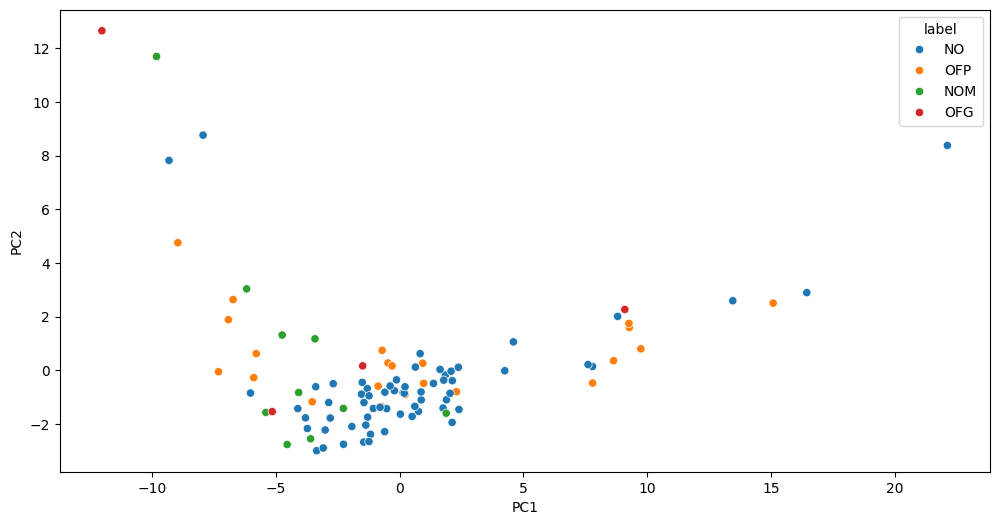

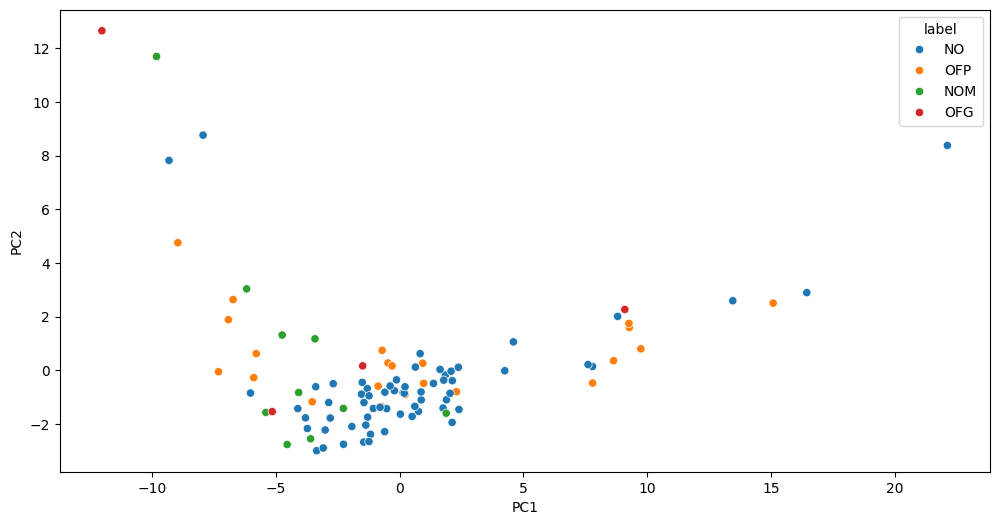

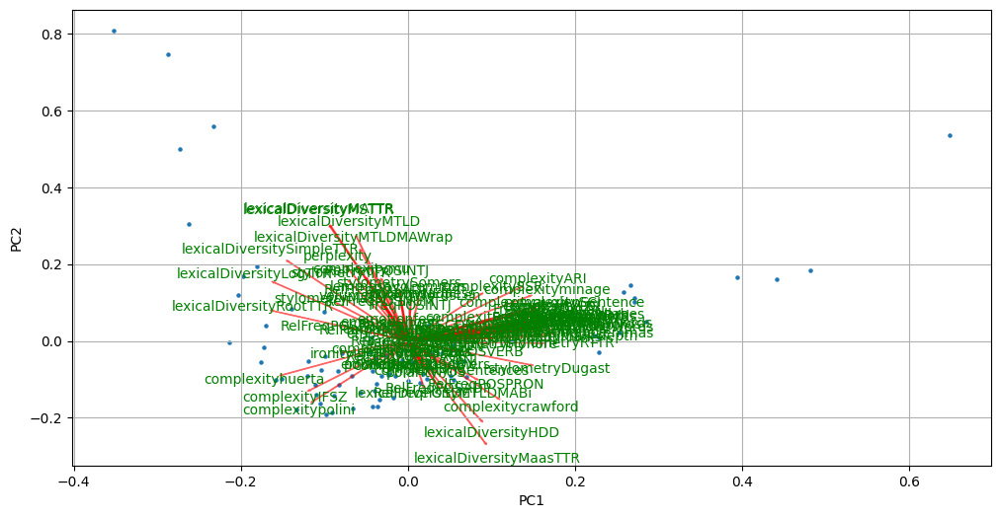

---------------------------- TSNE ----------------------------


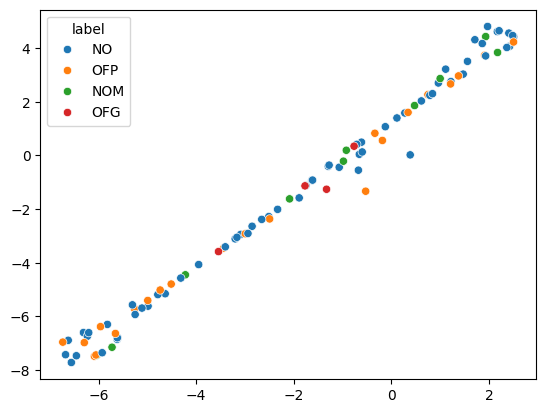

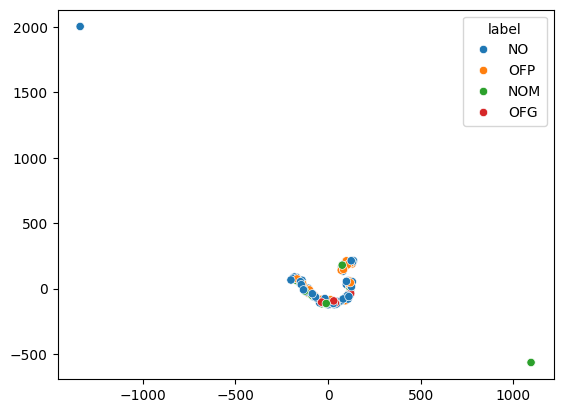

---------------------------- NNMF ----------------------------
error is 0.46
error is 0.43
error is 0.37
error is 0.36
error is 0.35
error is 0.35
error is 0.35
error is 0.35
error is 0.35
error is 0.35


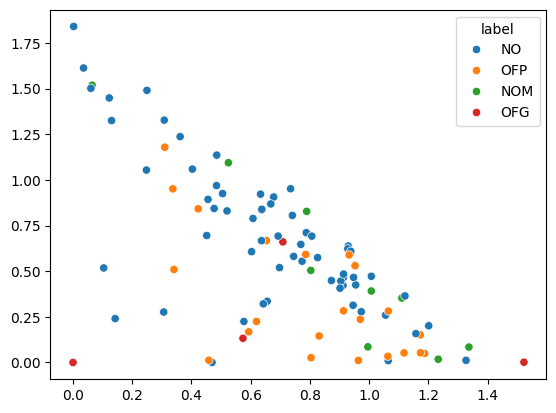

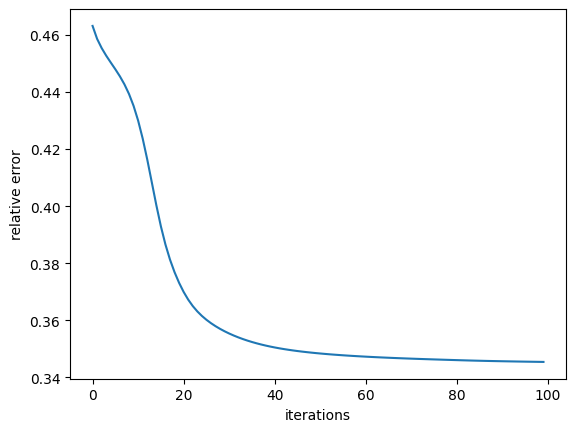

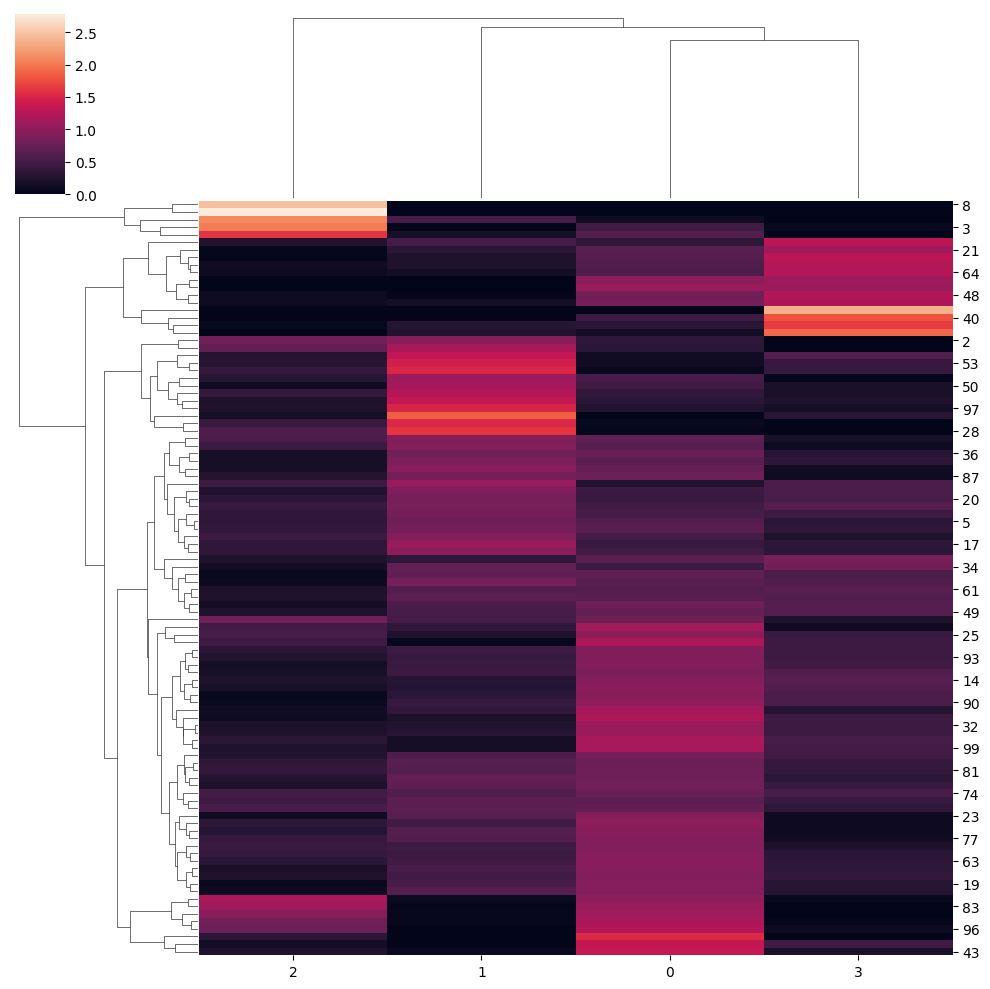

(array([[1.30126689e-01, 1.32505824e+00, 2.64523100e-01, 5.94117471e-01],
        [7.73643674e-01, 5.54693017e-01, 1.52261742e-01, 6.28571403e-01],
        [3.37229029e-01, 9.51238701e-01, 7.95465238e-01, 8.52076326e-07],
        [4.69618408e-01, 1.59142912e-04, 2.01259690e+00, 6.26861249e-02],
        [5.77111784e-01, 2.24735684e-01, 1.28763470e-01, 1.22674477e+00],
        [6.07882353e-01, 7.89057373e-01, 3.58134496e-01, 3.17972072e-01],
        [7.87878030e-01, 7.11118906e-01, 2.67432303e-01, 3.13124321e-01],
        [6.53273882e-01, 6.67275413e-01, 4.42208967e-01, 4.22975971e-01],
        [7.20113507e-04, 2.53016502e-04, 2.45592576e+00, 7.81237148e-05],
        [5.93630219e-01, 1.68019088e-01, 1.60250056e+00, 1.75480159e-05],
        [6.55702628e-01, 3.35378514e-01, 2.18143231e-01, 8.54632245e-01],
        [1.03696263e-01, 5.17813393e-01, 2.09908115e+00, 1.45867158e-04],
        [4.55928794e-01, 8.93627940e-01, 2.33496790e-01, 5.53333332e-01],
        [5.24694636e-01, 1.09420482e+0

In [31]:
print('---------------------------- PCA ----------------------------')
# Apply the PCA visualization function without biplot
v.show_pca(X, y, biplot= False, labelColumn= 'label')
# Apply the PCA visualization function with biplot
v.show_pca(X, y, labelColumn= 'label') 
print('---------------------------- TSNE ----------------------------')
# Apply the TSNE visualization function with default TSNE (tsne=TSNE(random_state = 0))
v.show_tsne(X, label=y)
# Apply the TSNE visualization function with customized TSNE (tsne=TSNE(random_state = 0))
v.show_tsne(X, tsne = TSNE(perplexity = 9, early_exaggeration = 11, learning_rate = 451, random_state = 0), label=y)
print('---------------------------- NNMF ----------------------------')
# Apply the NNMF visualization function
v.show_nnmf(4, X, y, 100)